In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Select the Runtime > "Change runtime type" menu to enable a GPU accelerator, ')
  print('and then re-execute this cell.')
else:
  print(gpu_info)

Tue Nov  3 17:24:48 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.32.00    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   34C    P8     9W /  70W |      0MiB / 15079MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
import os
import torch
from torch import nn
from torch.nn import functional as F
import torchvision
# Added additional imports
from torch.utils.data import Dataset, DataLoader, ConcatDataset
import torch.optim as optim
import cv2
from tqdm import tqdm
import numpy as np
from models import ConvolutionalVAE, VAE
import matplotlib.pyplot as plt
import pandas as pd
from collections import Counter
import imgaug.augmenters as iaa
# !pip install scikit-image
# !pip install imagehash
# !pip uninstall imgaug && pip install git+https://github.com/aleju/imgaug.git


value = (-35, 35)
assert [-255 <= value_ <= 255 for value_ in value] == [True, True]

sometimes = lambda aug: iaa.Sometimes(0.25, aug)
notmuch = lambda aug: iaa.Sometimes(0.05, aug)
seq = iaa.Sequential([
  sometimes(iaa.Add((-35, 35), per_channel=True)),
  sometimes(iaa.Multiply((0.5, 1.5))),
  sometimes(iaa.AddToHueAndSaturation((-15, 15))),
  notmuch(iaa.SigmoidContrast((0.3, 0.7)))
])

In [ ]:
class BTNxControlZonesDataset(Dataset):
    """BTNx Control Zones Dataset for easily iterating over and performing common operations."""
    def __init__(self, data_dir, image_size=64, train=False, transforms=None):
        super(BTNxControlZonesDataset).__init__()
        acceptable_image_extensions = ['.jpg', '.JPG', '.png', '.PNG']

        self.image_size = image_size
        self.train = train
        self.transforms = transforms

        self.filepaths, self.final_labels = [], []
        for path, subdirs, filenames in os.walk(data_dir):
            for filename in filenames:
                if any([filename.endswith(extension) for extension in acceptable_image_extensions]):
                    filepath = os.path.join(path, filename)
                    y = self.get_label(filepath=filepath)
                    # Skip if zone_no != 1 because we only want the control zones!
                    if y[0] != 1:
                      continue 

                    if y is not None:
                        self.filepaths.append(filepath)
                        self.final_labels.append(y)

        print('Loaded %d control zone images from BTNx Dataset' % len(self.filepaths))
        print('BTNx Control Zone Classes: %s' % str(Counter(self.final_labels)))

    def get_label(self, filepath):
      zone_no = int(os.path.splitext(filepath)[0].split('_')[-1].split('zone')[-1])
      zone_label = 1 if 'invalid' in filepath else 0
      return zone_no, zone_label

    def __len__(self):
        return len(self.filepaths)

    def __getitem__(self, index):
        if index <= self.__len__() - 1:
            filepath, y = self.filepaths[index], self.final_labels[index]
            x = cv2.imread(filepath)  # add 0 for grayscale
            x = cv2.cvtColor(x, cv2.COLOR_BGR2RGB)

            if self.train:
              x = seq(images=[x])[0]

            x = cv2.resize(x, (self.image_size, self.image_size))
            # x = cv2.GaussianBlur(x, (5, 5), 1) 

            x = torch.from_numpy(x).float().to(DEVICE)
            x = x / 255.0

            if len(x.shape) == 2: x = x.unsqueeze(-1)
            x = x.permute(2, 0, 1)
            y_zone_label = torch.tensor(data=y[1], dtype=torch.long).to(DEVICE)

            """
            # Apply transforms if applicable
            if self.transforms is not None:
              x = self.transforms(x)
            """
        else:
            raise ValueError('Out of range index while accessing dataset')

        return x, y_zone_label

In [ ]:
NUM_CHANNELS = 3
BATCH_SIZE = 100 # 32
IMG_SIZE = 64
INPUT_SHAPE = (BATCH_SIZE, NUM_CHANNELS * IMG_SIZE * IMG_SIZE)
LEARNING_RATE = 4E-3 # 1E-5 # 7E-3
NUM_EPOCHS = 1500
KERNEL_SIZE = 3
LATENT_DIM = 100
# HIDDEN_DIMS = [2048]
HIDDEN_DIMS = [32, 64, 128, 256, 512]
BETA = 0 # 0.005 # 0.01
GAMMA = 255
ENCODER_ACTIVATION_FN = F.leaky_relu
DECODER_ACTIVATION_FN = F.leaky_relu
OUTPUT_ACTIVATION_FN = torch.sigmoid
USE_BATCH_NORMALIATION = True

DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print("DEVICE FOUND: %s" % DEVICE)

train_dataset = BTNxControlZonesDataset(data_dir='gdrive/My Drive/generative/btnx_zones/train_btnx_zones', image_size=IMG_SIZE, train=True)
test_dataset = BTNxControlZonesDataset(data_dir='gdrive/My Drive/generative/btnx_zones/test_btnx_zones', image_size=IMG_SIZE, train=False)
invalid_dataset = BTNxControlZonesDataset(data_dir='gdrive/My Drive/generative/btnx_zones/invalid_green_zone_btnx_zones', image_size=IMG_SIZE, train=False) 

train_loader = DataLoader(dataset=train_dataset, batch_size=BATCH_SIZE, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=BATCH_SIZE, shuffle=True)
invalid_loader = DataLoader(dataset=invalid_dataset, batch_size=BATCH_SIZE, shuffle=True)

if not os.path.exists('saved_models'):
  !mkdir saved_models

DEVICE FOUND: cuda
Loaded 383 control zone images from BTNx Dataset
BTNx Control Zone Classes: Counter({(1, 0): 383})
Loaded 339 control zone images from BTNx Dataset
BTNx Control Zone Classes: Counter({(1, 0): 339})
Loaded 27 control zone images from BTNx Dataset
BTNx Control Zone Classes: Counter({(1, 1): 27})


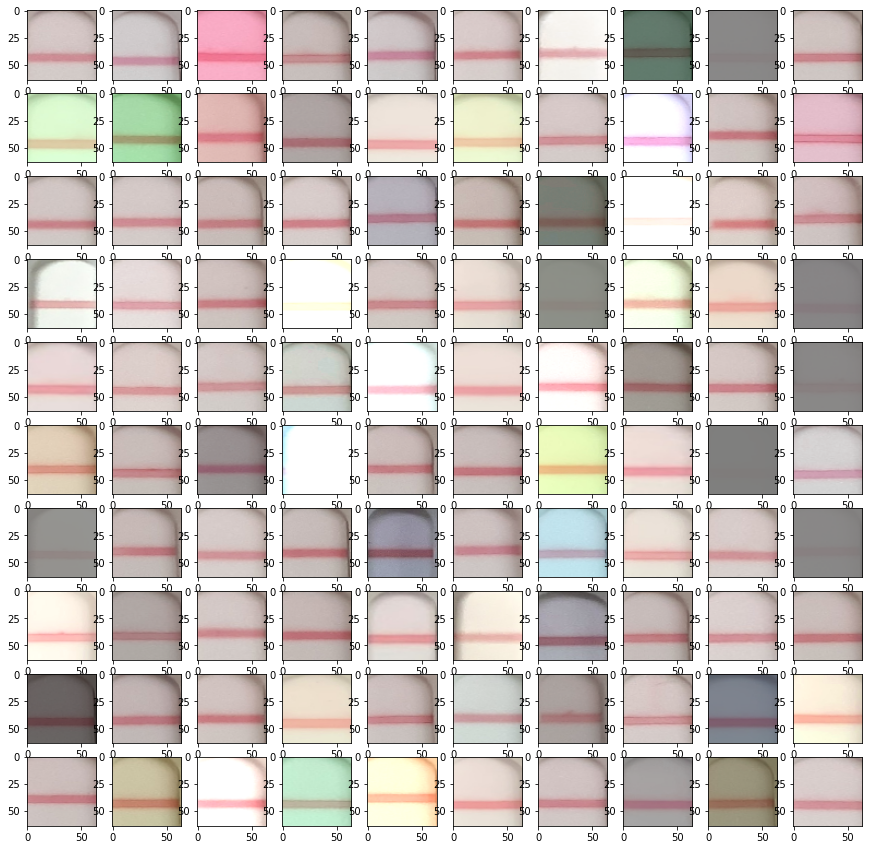

<Figure size 432x288 with 0 Axes>

In [ ]:
for batch in train_loader:
  x, y = batch
  fig, ax = plt.subplots(10, 10, figsize=(15, 15))
  for i in range(100):
    row, column = i % 10, i // 10
    ax[row][column].imshow(x[i, :, :, :].cpu().detach().permute(1, 2, 0))
  break
plt.show()
plt.savefig('augmented_images.jpg')

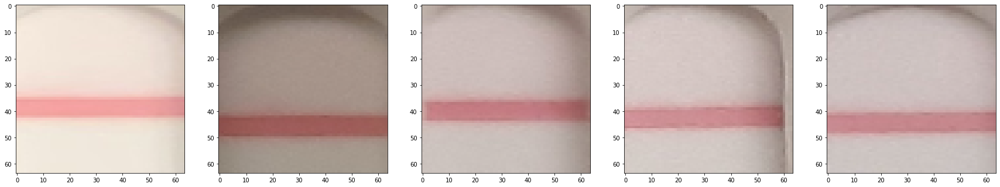

In [ ]:
for batch in test_loader:
  x, y = batch
  fig, ax = plt.subplots(1, 5, figsize=(30, 30))
  for i in range(5):
    ax[i].imshow(x[i, :, :, :].cpu().detach().permute(1, 2, 0))
  break
plt.show()

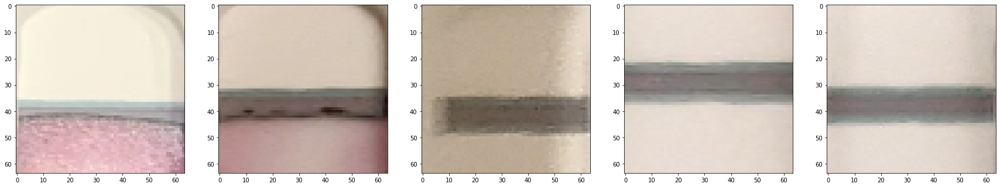

In [ ]:
for batch in invalid_loader:
  x, y = batch
  fig, ax = plt.subplots(1, 5, figsize=(30, 30))
  for i in range(5):
    ax[i].imshow(x[i, :, :, :].cpu().detach().permute(1, 2, 0))
  break
plt.show()

In [ ]:
"""
model = VAE(input_shape=INPUT_SHAPE,
            latent_dim=LATENT_DIM,
            encoder_activation_fn=F.leaky_relu,
            decoder_activation_fn=F.leaky_relu,
            output_activation_fn=torch.sigmoid,
            hidden_dims=HIDDEN_DIMS,
            gamma=GAMMA,
            beta=BETA,
            device=DEVICE,
            use_batch_normalization=True)
"""

model = ConvolutionalVAE(batch_size=BATCH_SIZE,
                         num_channels=NUM_CHANNELS,
                         img_size=IMG_SIZE,
                         kernel_size=KERNEL_SIZE,
                         latent_dim=LATENT_DIM,
                         encoder_activation_fn=ENCODER_ACTIVATION_FN,
                         decoder_activation_fn=DECODER_ACTIVATION_FN,
                         output_activation_fn=OUTPUT_ACTIVATION_FN,
                         hidden_dims=HIDDEN_DIMS,
                         gamma=GAMMA,
                         beta=BETA,
                         device=DEVICE,
                         use_batch_normalization=USE_BATCH_NORMALIZATION)
model.to(DEVICE)
model

Base Input Shape: (32, 3, 64, 64)
Encoder Output Shape:  (32, 512, 1, 1)
Mu and LogVar Shape: (32, 100)
Decoder Output Shape: (32, 3, 63, 63)
Using UpSample(.) to resize the final tensor to base input shape!


ConvolutionalVAE(
  (encoder): ConvolutionalEncoder(
    (conv_blocks): ModuleList(
      (0): ConvBlock(
        (conv): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2))
        (batch_norm): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): ConvBlock(
        (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2))
        (batch_norm): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (2): ConvBlock(
        (conv): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2))
        (batch_norm): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (3): ConvBlock(
        (conv): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2))
        (batch_norm): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (4): ConvBlock(
        (conv): Conv2d(256, 512, kernel_size=(3, 3), stride=(2, 2))
        (batch_norm): BatchNor

In [ ]:
# optimizer = optim.Adam(params=model.parameters(), lr=LEARNING_RATE)
optimizer = optim.Adam(params=model.parameters(), lr=3E-4)
lr_scheduler = optim.lr_scheduler.ExponentialLR(optimizer=optimizer, gamma=0.995)

best_test_loss = float('inf')
for epoch in tqdm(range(NUM_EPOCHS), desc='Iterating over Epochs', position=0, leave=True):
    epoch_loss = 0.0
    model.train()
    for batch in train_loader:
        x, y = batch[0].to(DEVICE), batch[1].to(DEVICE)
        # x = x.view(x.shape[0], -1)

        optimizer.zero_grad()

        x_hat, mu, logvar = model(x)
        loss = model.loss_function(x=x, x_hat=x_hat, mu=mu, logvar=logvar)

        loss.backward()
        optimizer.step()
        lr_scheduler.step()

        epoch_loss += loss.item()

    train_loss = epoch_loss / len(train_loader)

    epoch_loss = 0.0
    model.eval()
    with torch.no_grad():
        for batch in test_loader:
            x, y = batch[0].to(DEVICE), batch[1].to(DEVICE)
            # x = x.view(x.shape[0], -1)

            x_hat, mu, logvar = model(x)
            loss = model.loss_function(x=x, x_hat=x_hat, mu=mu, logvar=logvar)
            epoch_loss += loss.item()

    test_loss = epoch_loss / len(test_loader)

    if test_loss < best_test_loss:
        best_test_loss = test_loss
        torch.save(model.state_dict(), os.path.join('saved_models', 'btnx_valid_control_zone_vae.pt'))
        z = torch.randn(size=(1, LATENT_DIM)).to(DEVICE)
        z = z 
        x_hat = model.decode(z)
        x_hat[x_hat < 0.] = 0
        x_hat = x_hat.view(-1, NUM_CHANNELS, IMG_SIZE, IMG_SIZE)
        plt.imshow(x_hat[0, :, :, :].cpu().detach().permute(1, 2, 0))
        plt.show()

    print(f'\tTrain Loss: {train_loss:.3f} | Test Loss: {test_loss:.3f}')

Iterating over Epochs:   0%|          | 0/1500 [00:02<?, ?it/s]


KeyboardInterrupt: ignored

In [ ]:
# model.load_state_dict(torch.load('saved_models/btnx_valid_control_zone_vae.pt'))
model.load_state_dict(torch.load('outlier_beta=255_gamma=0_threshold=1.45.pt'))

<All keys matched successfully>

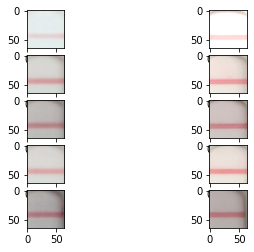

In [ ]:
fig, ax = plt.subplots(5, 2)
for i, batch in enumerate(train_loader):
  for j in range(5):
    x, y = batch

    # out = model(batch[0].view(batch[0].shape[0], -1))
    out = model(batch[0])
    x_hat = out[0][j]

    x_hat[x_hat < 0.] = 0.
    x_hat[x_hat > 1.] = 1.
    x_hat = x_hat.view(NUM_CHANNELS, IMG_SIZE, IMG_SIZE)
    ax[j][1].imshow(batch[0][j][:, :, :].cpu().detach().permute(1,2,0))
    ax[j][0].imshow(x_hat[:, :, :].cpu().detach().permute(1,2,0))
  
  break
  
plt.show()

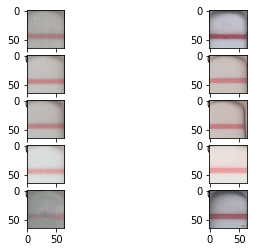

In [ ]:
fig, ax = plt.subplots(5, 2)
for i, batch in enumerate(test_loader):
  for j in range(5):
    x, y = batch

    # out = model(batch[0].view(batch[0].shape[0], -1))
    out = model(batch[0])
    x_hat = out[0][j]

    x_hat[x_hat < 0.] = 0.
    x_hat = x_hat.view(NUM_CHANNELS, IMG_SIZE, IMG_SIZE)
    ax[j][1].imshow(batch[0][j][:, :, :].cpu().detach().permute(1,2,0))
    ax[j][0].imshow(x_hat[:, :, :].cpu().detach().permute(1,2,0))
  
  break
  
plt.show()

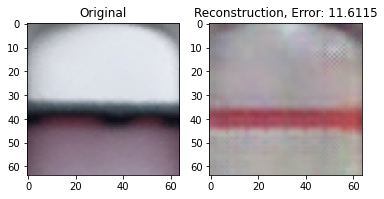

-----------------------------------------------------------------------------


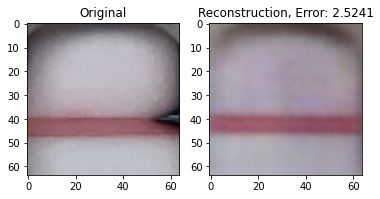

-----------------------------------------------------------------------------


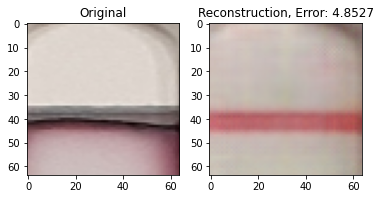

-----------------------------------------------------------------------------


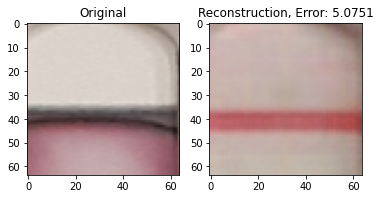

-----------------------------------------------------------------------------


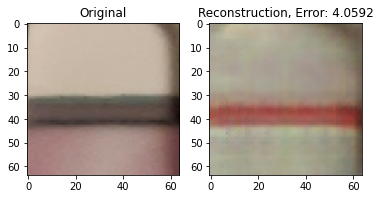

-----------------------------------------------------------------------------


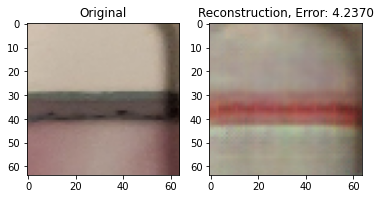

-----------------------------------------------------------------------------


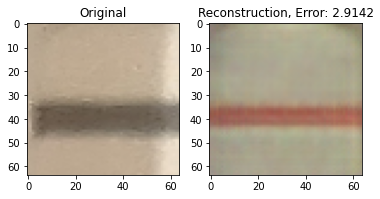

-----------------------------------------------------------------------------


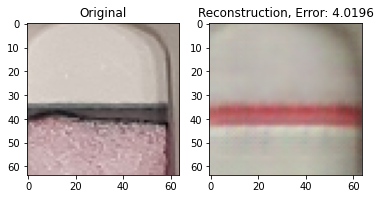

-----------------------------------------------------------------------------


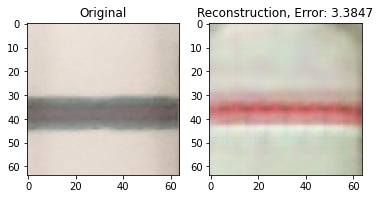

-----------------------------------------------------------------------------


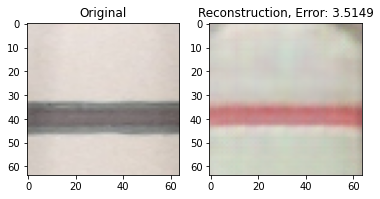

-----------------------------------------------------------------------------


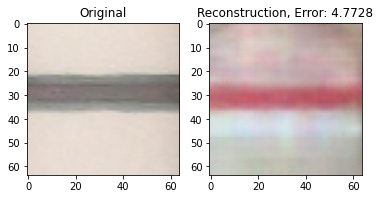

-----------------------------------------------------------------------------


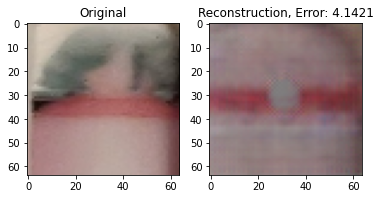

-----------------------------------------------------------------------------


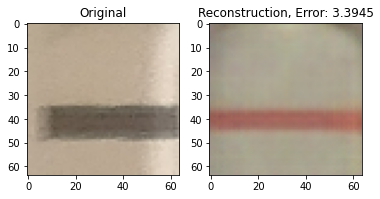

-----------------------------------------------------------------------------


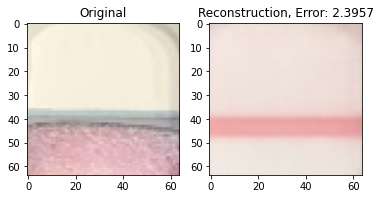

-----------------------------------------------------------------------------


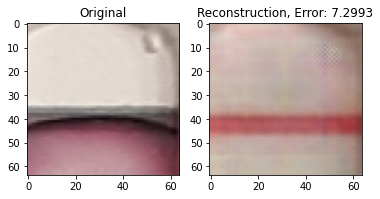

-----------------------------------------------------------------------------


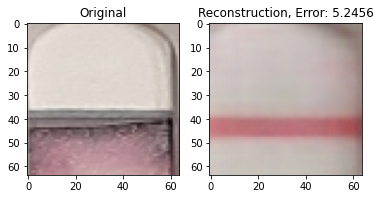

-----------------------------------------------------------------------------


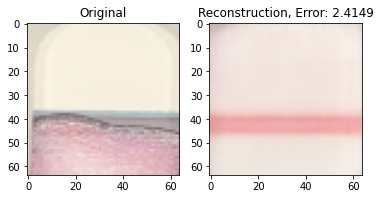

-----------------------------------------------------------------------------


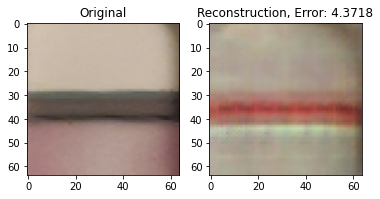

-----------------------------------------------------------------------------


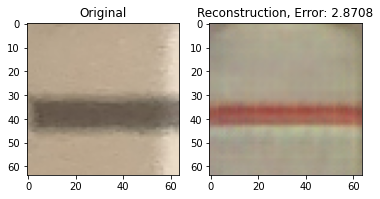

-----------------------------------------------------------------------------


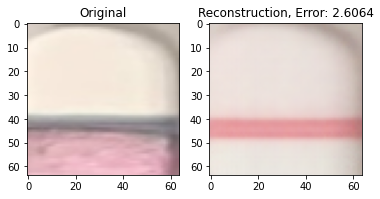

-----------------------------------------------------------------------------


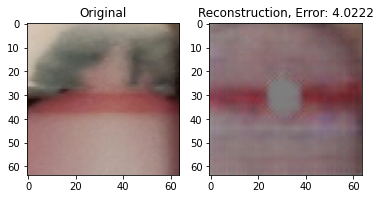

-----------------------------------------------------------------------------


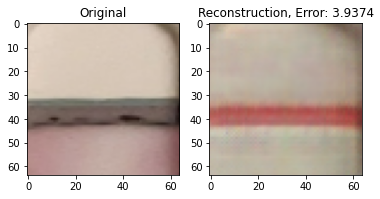

-----------------------------------------------------------------------------


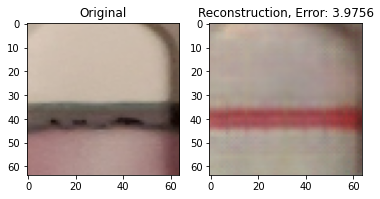

-----------------------------------------------------------------------------


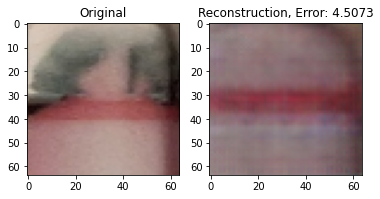

-----------------------------------------------------------------------------


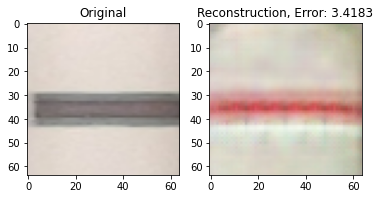

-----------------------------------------------------------------------------


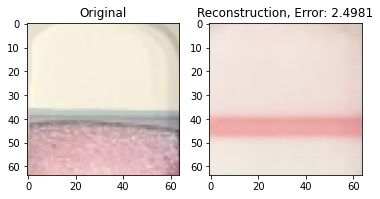

-----------------------------------------------------------------------------


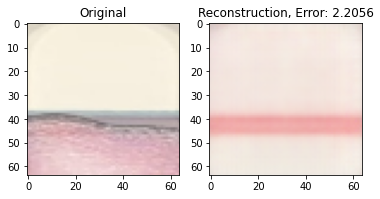

-----------------------------------------------------------------------------


In [ ]:
from losses import reconstruction_loss
invalid_loader = DataLoader(dataset=invalid_dataset, batch_size=1, shuffle=False)
model.eval()
for i, batch in enumerate(invalid_loader):
  x, y = batch
  # x = x.view(x.shape[0], -1)
   
  x_hat, mu, logvar = model(x)
  x_hat[x_hat < 0.] = 0.
  x_hat[x_hat > 1.] = 1.

  # loss = reconstruction_loss(x=x, x_hat=x_hat)
  loss = model.loss_function(x=x, x_hat=x_hat, mu=mu, logvar=logvar)

  x = x[0].view(NUM_CHANNELS, IMG_SIZE, IMG_SIZE)
  x_hat = x_hat[0].view(NUM_CHANNELS, IMG_SIZE, IMG_SIZE)

  fig, ax = plt.subplots(1, 2)
  ax[0].imshow(x[:, :, :].cpu().detach().permute(1,2,0))
  ax[0].set_title('Original')
  ax[1].imshow(x_hat[:, :, :].cpu().detach().permute(1,2,0))
  ax[1].set_title('Reconstruction, Error: %0.4f' % loss.item())
  plt.show()
  print('-----------------------------------------------------------------------------')

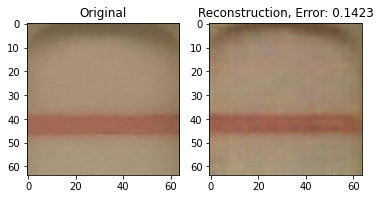

-----------------------------------------------------------------------------


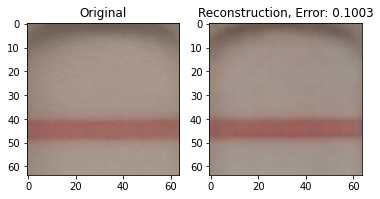

-----------------------------------------------------------------------------


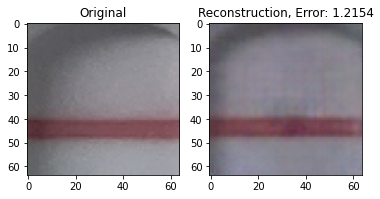

-----------------------------------------------------------------------------


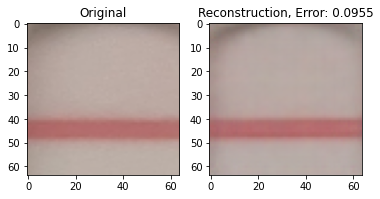

-----------------------------------------------------------------------------


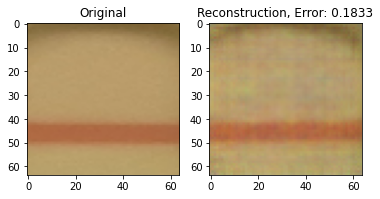

-----------------------------------------------------------------------------


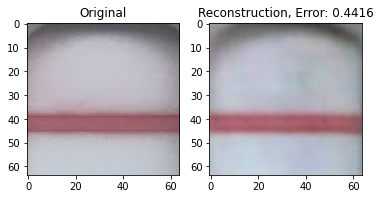

-----------------------------------------------------------------------------


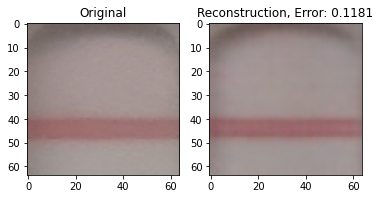

-----------------------------------------------------------------------------


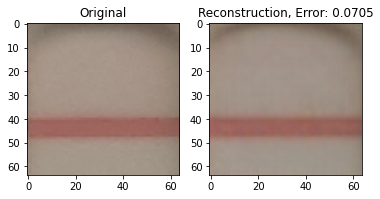

-----------------------------------------------------------------------------


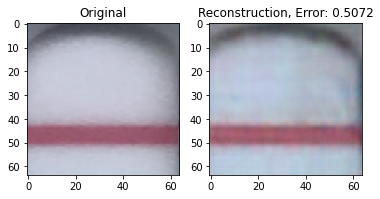

-----------------------------------------------------------------------------


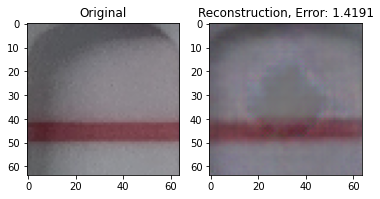

-----------------------------------------------------------------------------


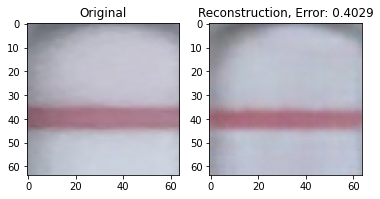

-----------------------------------------------------------------------------


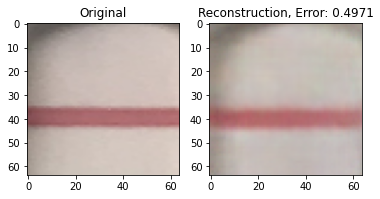

-----------------------------------------------------------------------------


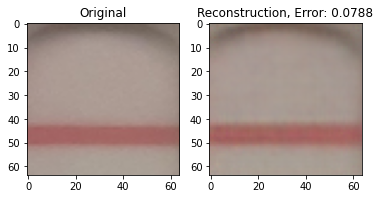

-----------------------------------------------------------------------------


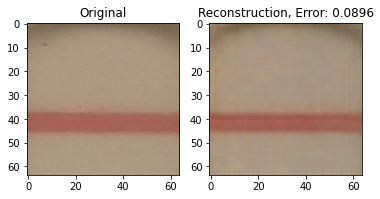

-----------------------------------------------------------------------------


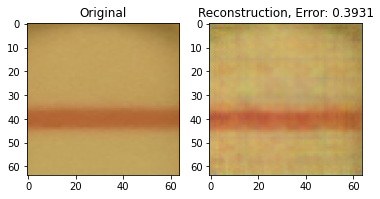

-----------------------------------------------------------------------------


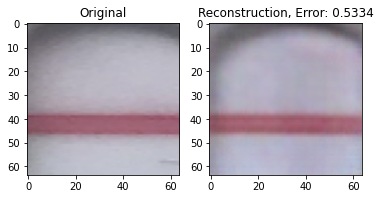

-----------------------------------------------------------------------------


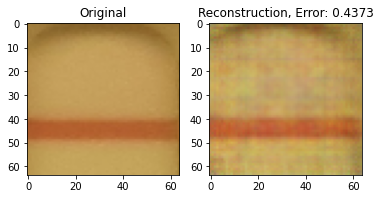

-----------------------------------------------------------------------------


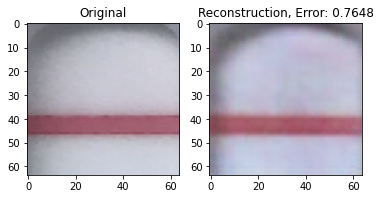

-----------------------------------------------------------------------------


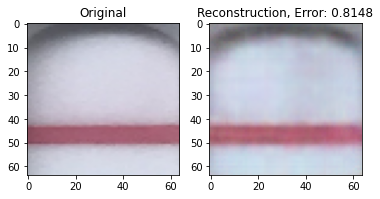

-----------------------------------------------------------------------------


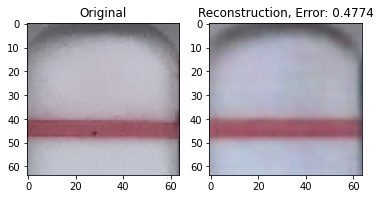

-----------------------------------------------------------------------------


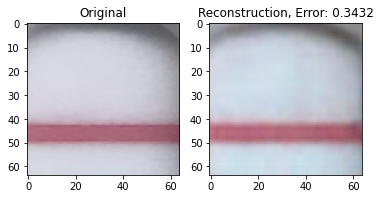

-----------------------------------------------------------------------------


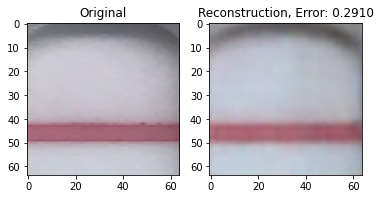

-----------------------------------------------------------------------------


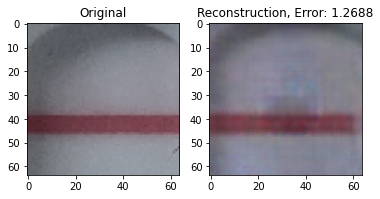

-----------------------------------------------------------------------------


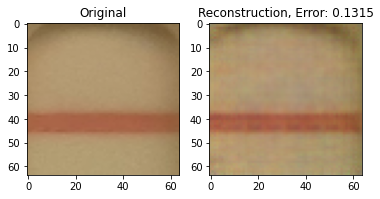

-----------------------------------------------------------------------------


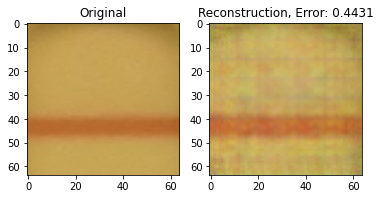

-----------------------------------------------------------------------------


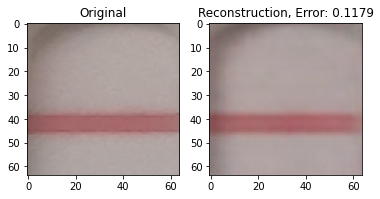

-----------------------------------------------------------------------------


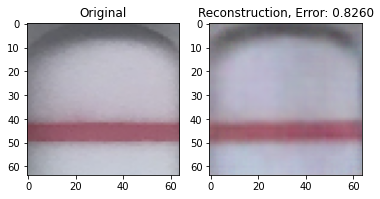

-----------------------------------------------------------------------------


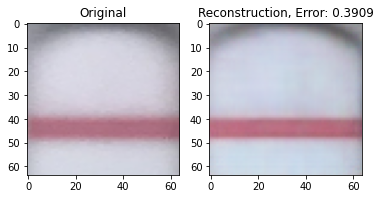

-----------------------------------------------------------------------------


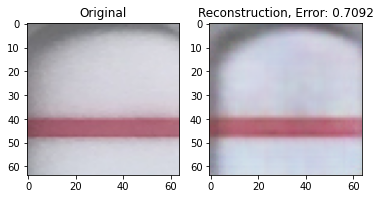

-----------------------------------------------------------------------------


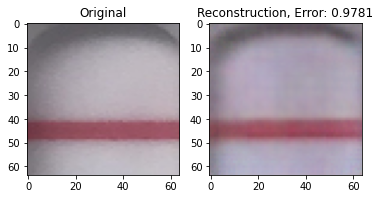

-----------------------------------------------------------------------------


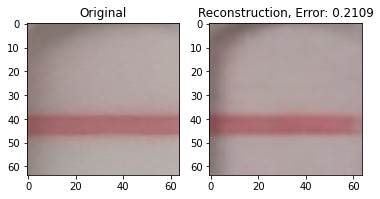

-----------------------------------------------------------------------------


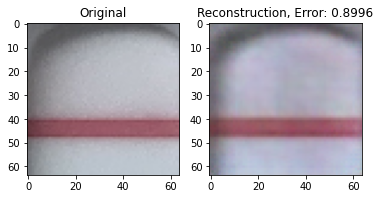

-----------------------------------------------------------------------------


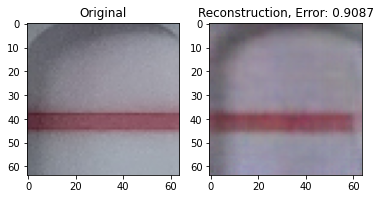

-----------------------------------------------------------------------------


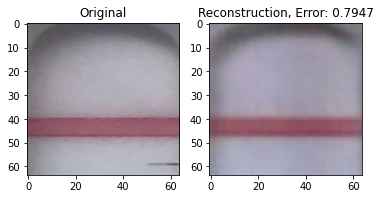

-----------------------------------------------------------------------------


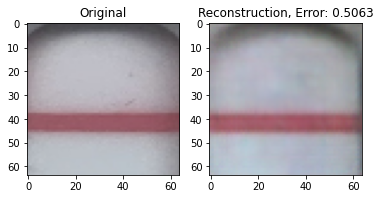

-----------------------------------------------------------------------------


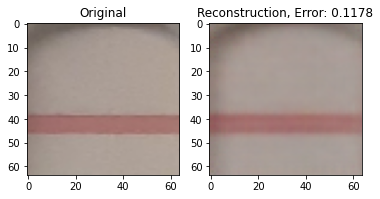

-----------------------------------------------------------------------------


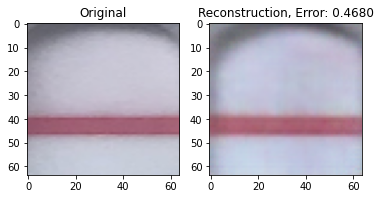

-----------------------------------------------------------------------------


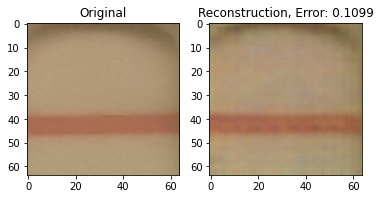

-----------------------------------------------------------------------------


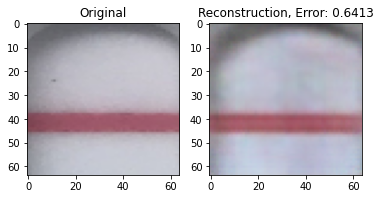

-----------------------------------------------------------------------------


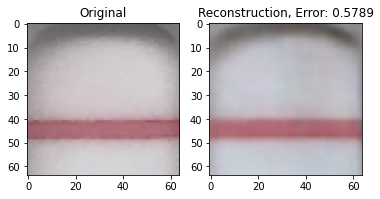

-----------------------------------------------------------------------------


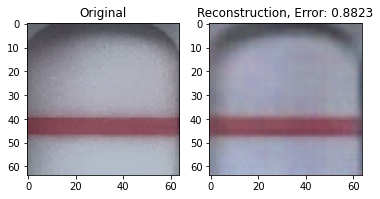

-----------------------------------------------------------------------------


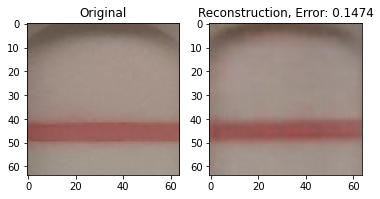

-----------------------------------------------------------------------------


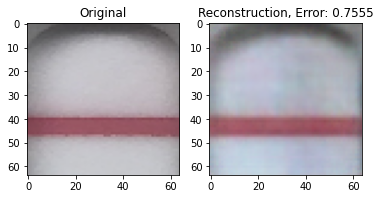

-----------------------------------------------------------------------------


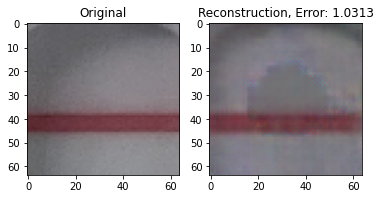

-----------------------------------------------------------------------------


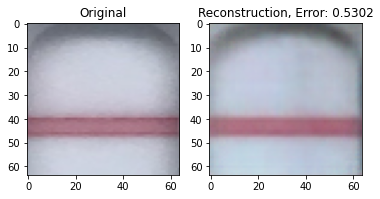

-----------------------------------------------------------------------------


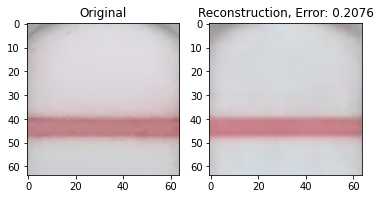

-----------------------------------------------------------------------------


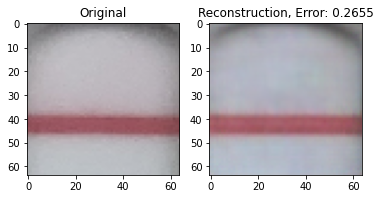

-----------------------------------------------------------------------------


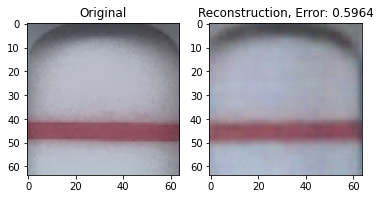

-----------------------------------------------------------------------------


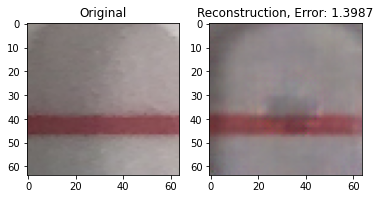

-----------------------------------------------------------------------------


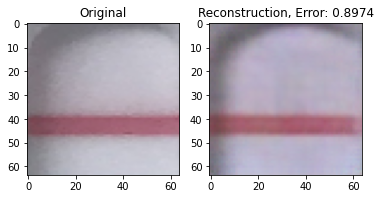

-----------------------------------------------------------------------------


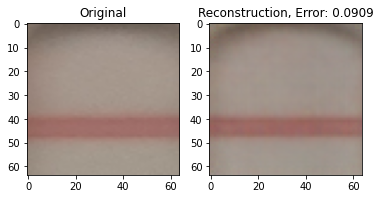

-----------------------------------------------------------------------------


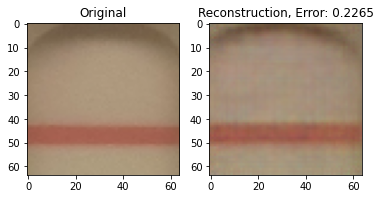

-----------------------------------------------------------------------------


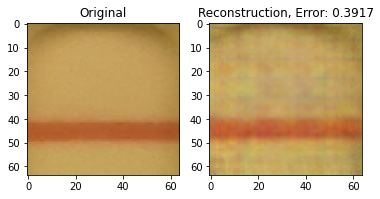

-----------------------------------------------------------------------------


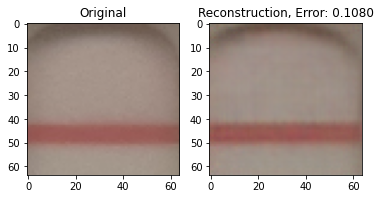

-----------------------------------------------------------------------------


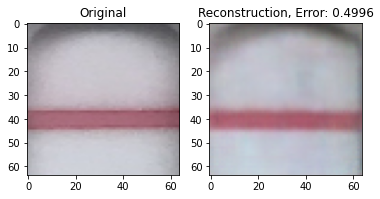

-----------------------------------------------------------------------------


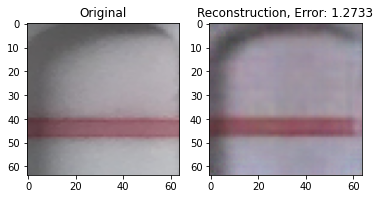

-----------------------------------------------------------------------------


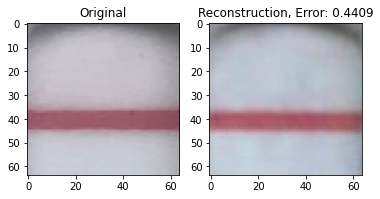

-----------------------------------------------------------------------------


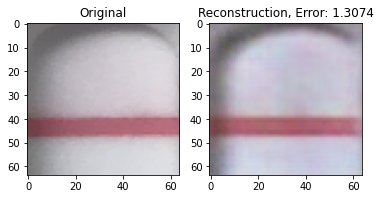

-----------------------------------------------------------------------------


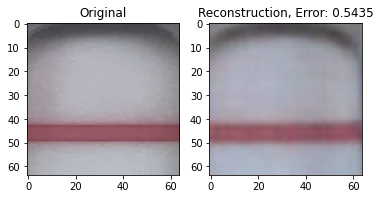

-----------------------------------------------------------------------------


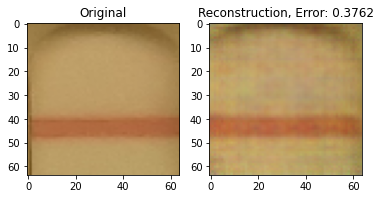

-----------------------------------------------------------------------------


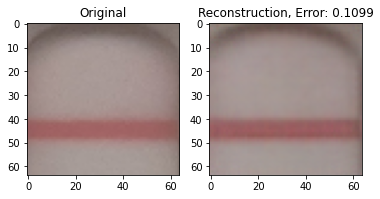

-----------------------------------------------------------------------------


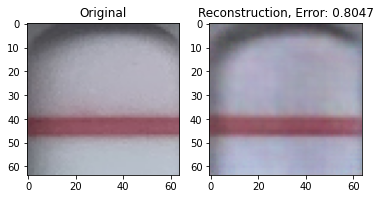

-----------------------------------------------------------------------------


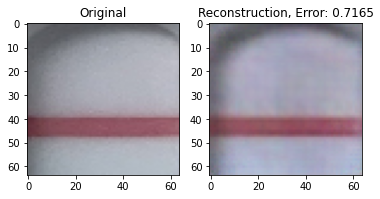

-----------------------------------------------------------------------------


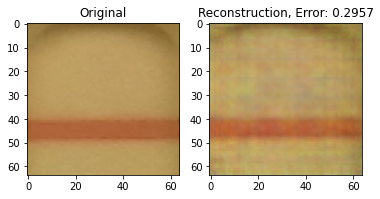

-----------------------------------------------------------------------------


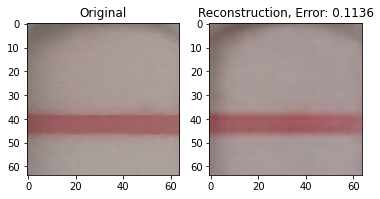

-----------------------------------------------------------------------------


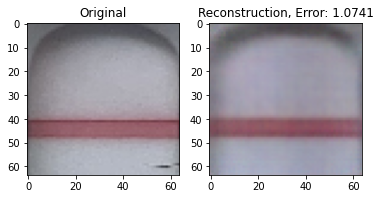

-----------------------------------------------------------------------------


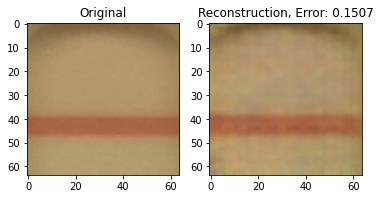

-----------------------------------------------------------------------------


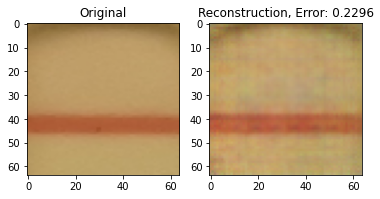

-----------------------------------------------------------------------------


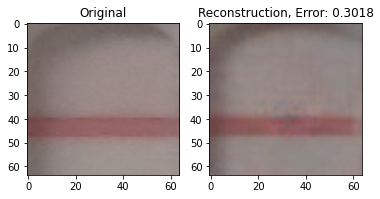

-----------------------------------------------------------------------------


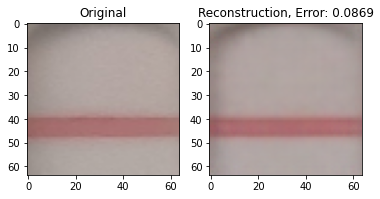

-----------------------------------------------------------------------------


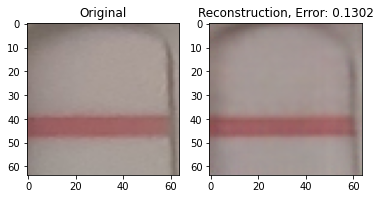

-----------------------------------------------------------------------------


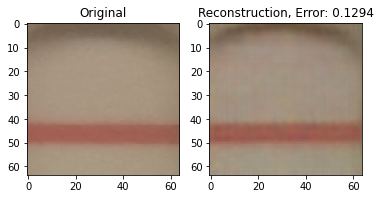

-----------------------------------------------------------------------------


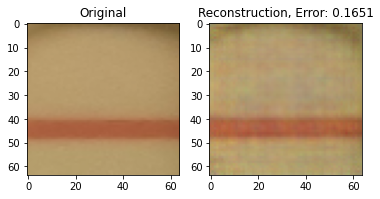

-----------------------------------------------------------------------------


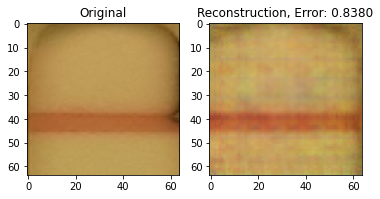

-----------------------------------------------------------------------------


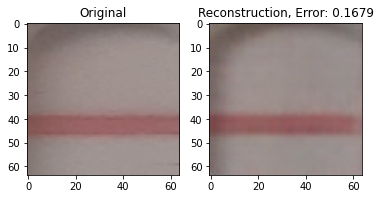

-----------------------------------------------------------------------------


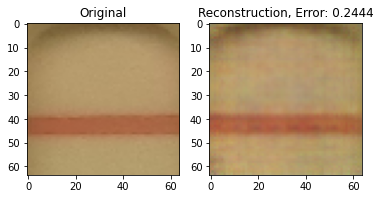

-----------------------------------------------------------------------------


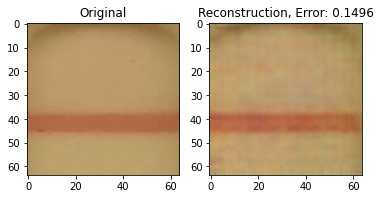

-----------------------------------------------------------------------------


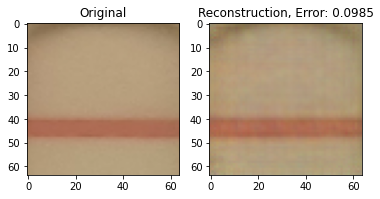

-----------------------------------------------------------------------------


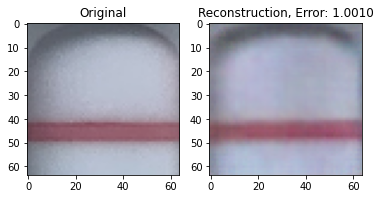

-----------------------------------------------------------------------------


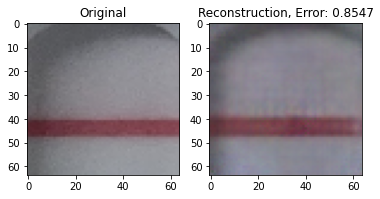

-----------------------------------------------------------------------------


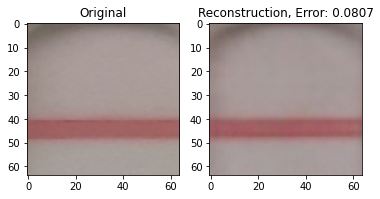

-----------------------------------------------------------------------------


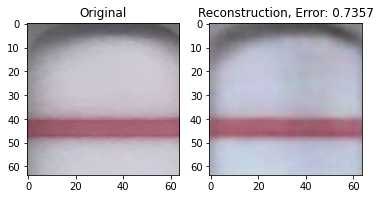

-----------------------------------------------------------------------------


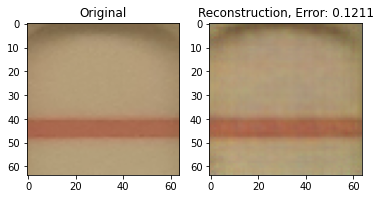

-----------------------------------------------------------------------------


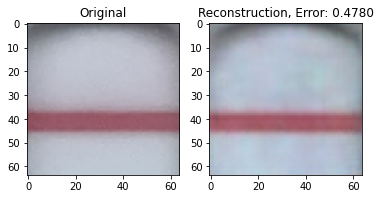

-----------------------------------------------------------------------------


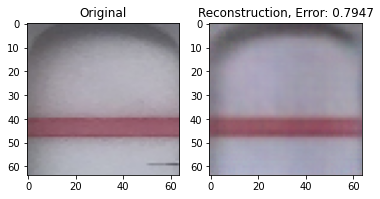

-----------------------------------------------------------------------------


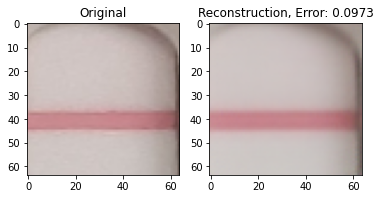

-----------------------------------------------------------------------------


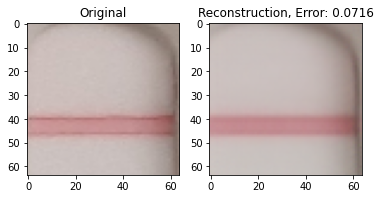

-----------------------------------------------------------------------------


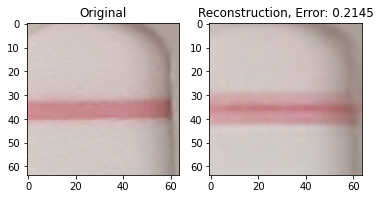

-----------------------------------------------------------------------------


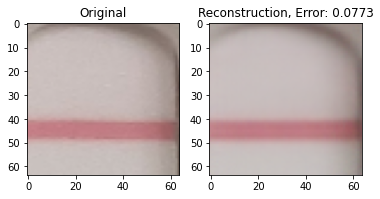

-----------------------------------------------------------------------------


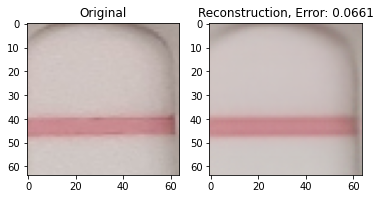

-----------------------------------------------------------------------------


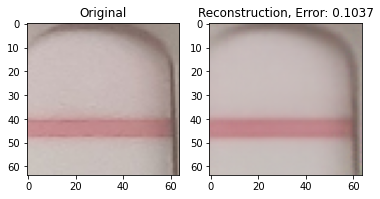

-----------------------------------------------------------------------------


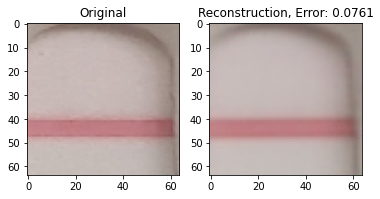

-----------------------------------------------------------------------------


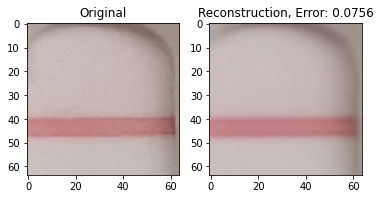

-----------------------------------------------------------------------------


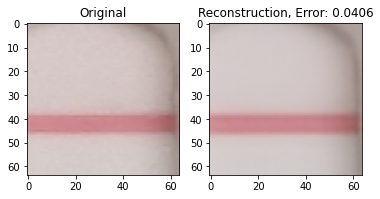

-----------------------------------------------------------------------------


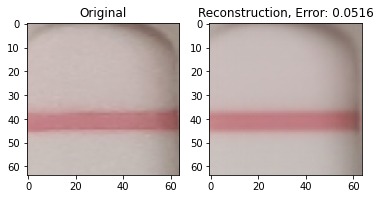

-----------------------------------------------------------------------------


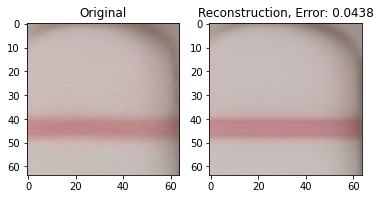

-----------------------------------------------------------------------------


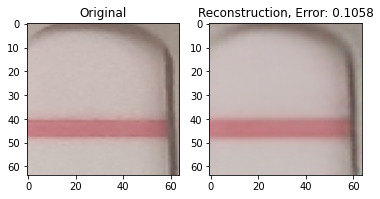

-----------------------------------------------------------------------------


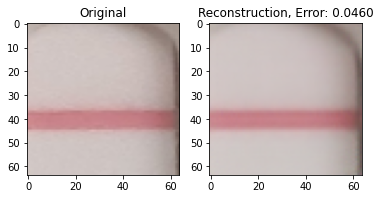

-----------------------------------------------------------------------------


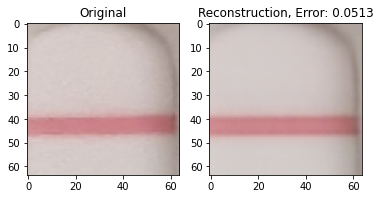

-----------------------------------------------------------------------------


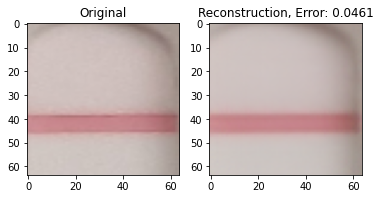

-----------------------------------------------------------------------------


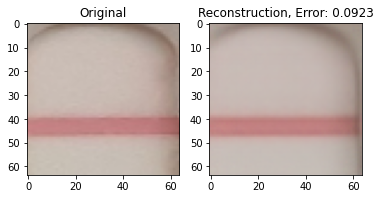

-----------------------------------------------------------------------------


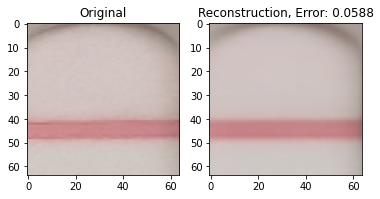

-----------------------------------------------------------------------------


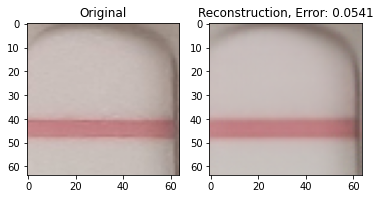

-----------------------------------------------------------------------------


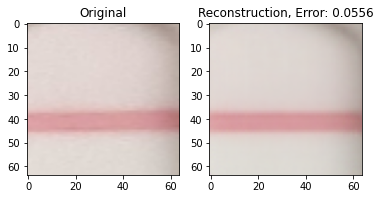

-----------------------------------------------------------------------------


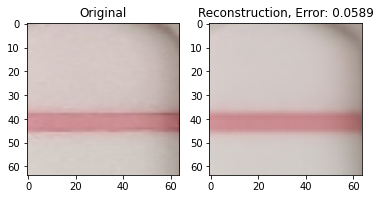

-----------------------------------------------------------------------------


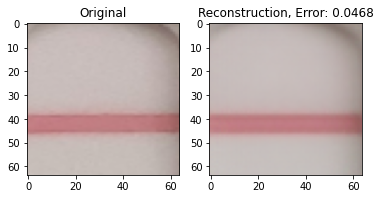

-----------------------------------------------------------------------------


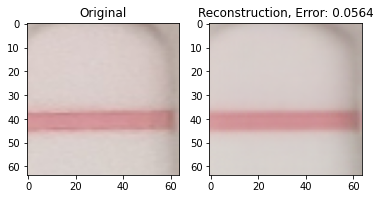

-----------------------------------------------------------------------------


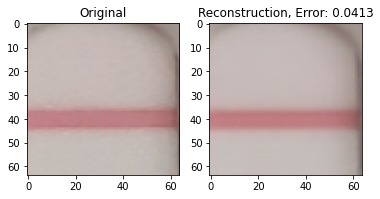

-----------------------------------------------------------------------------


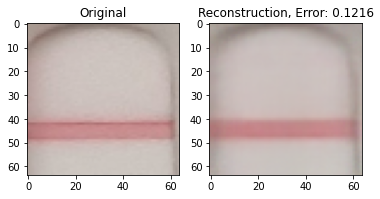

-----------------------------------------------------------------------------


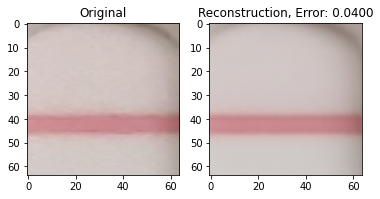

-----------------------------------------------------------------------------


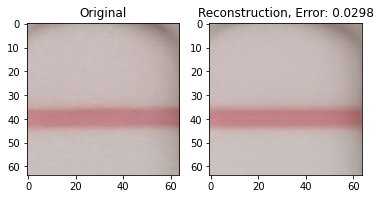

-----------------------------------------------------------------------------


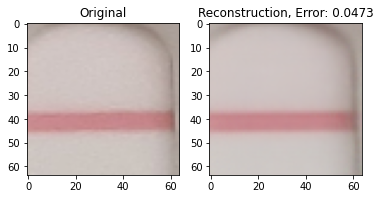

-----------------------------------------------------------------------------


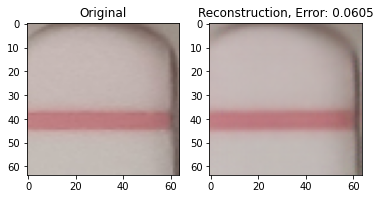

-----------------------------------------------------------------------------


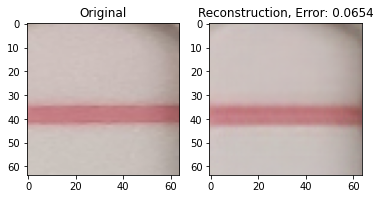

-----------------------------------------------------------------------------


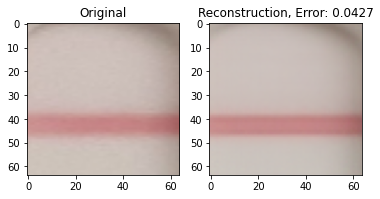

-----------------------------------------------------------------------------


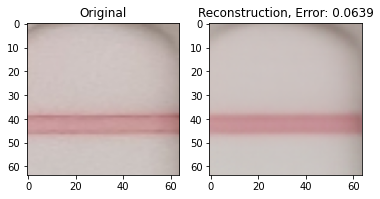

-----------------------------------------------------------------------------


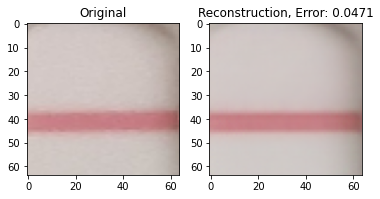

-----------------------------------------------------------------------------


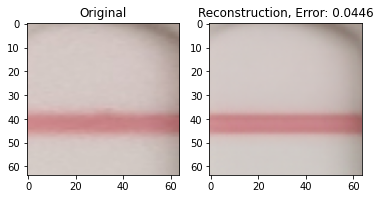

-----------------------------------------------------------------------------


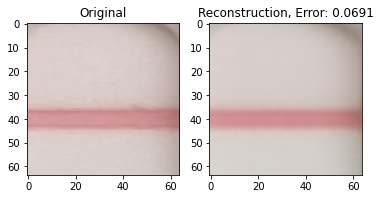

-----------------------------------------------------------------------------


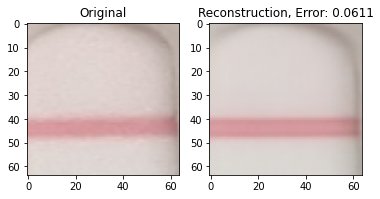

-----------------------------------------------------------------------------


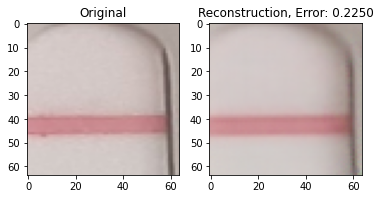

-----------------------------------------------------------------------------


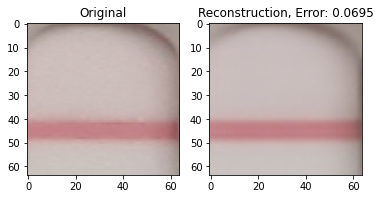

-----------------------------------------------------------------------------


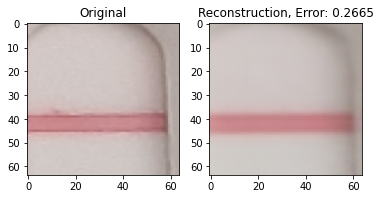

-----------------------------------------------------------------------------


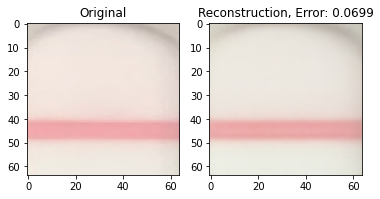

-----------------------------------------------------------------------------


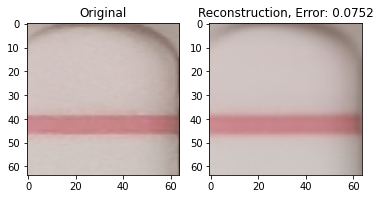

-----------------------------------------------------------------------------


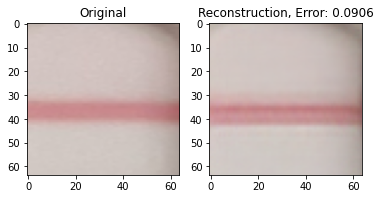

-----------------------------------------------------------------------------


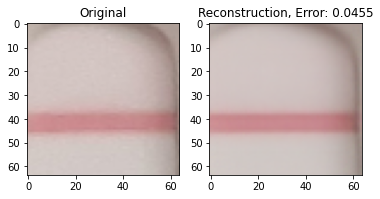

-----------------------------------------------------------------------------


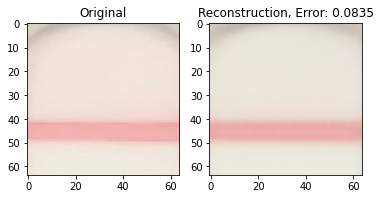

-----------------------------------------------------------------------------


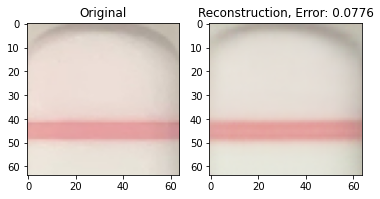

-----------------------------------------------------------------------------


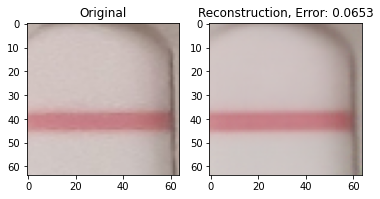

-----------------------------------------------------------------------------


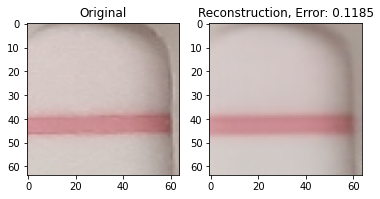

-----------------------------------------------------------------------------


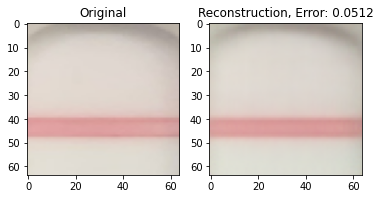

-----------------------------------------------------------------------------


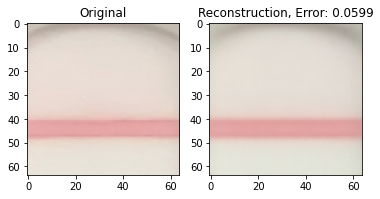

-----------------------------------------------------------------------------


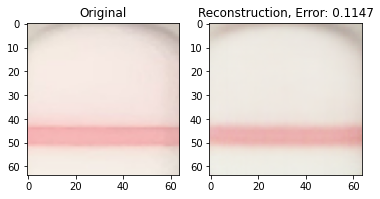

-----------------------------------------------------------------------------


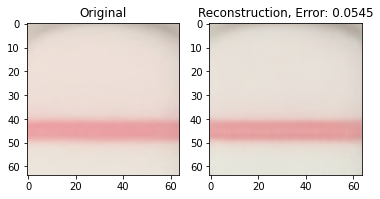

-----------------------------------------------------------------------------


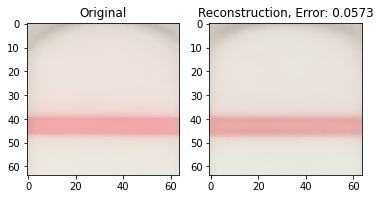

-----------------------------------------------------------------------------


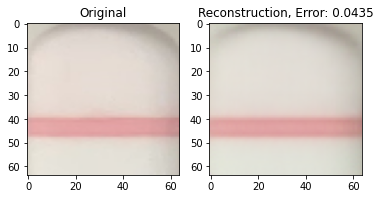

-----------------------------------------------------------------------------


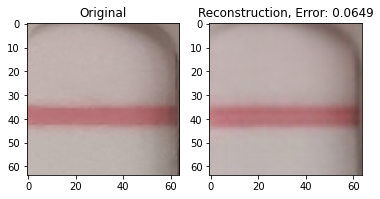

-----------------------------------------------------------------------------


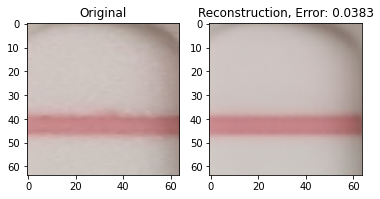

-----------------------------------------------------------------------------


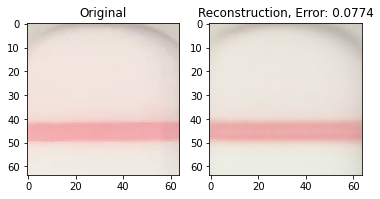

-----------------------------------------------------------------------------


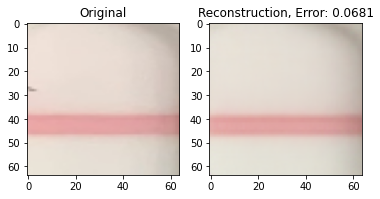

-----------------------------------------------------------------------------


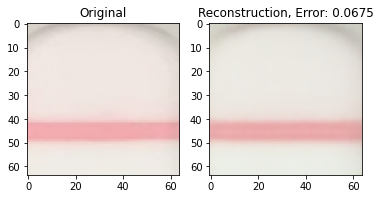

-----------------------------------------------------------------------------


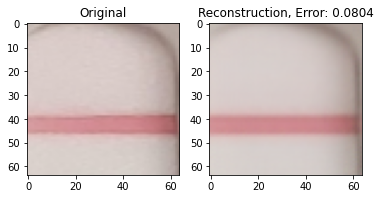

-----------------------------------------------------------------------------


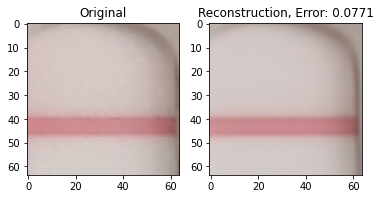

-----------------------------------------------------------------------------


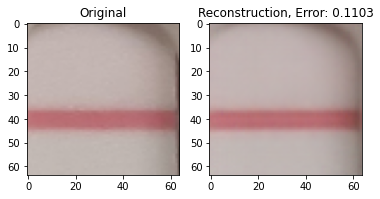

-----------------------------------------------------------------------------


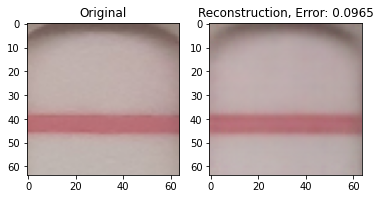

-----------------------------------------------------------------------------


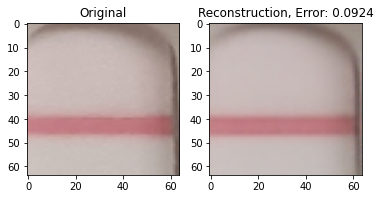

-----------------------------------------------------------------------------


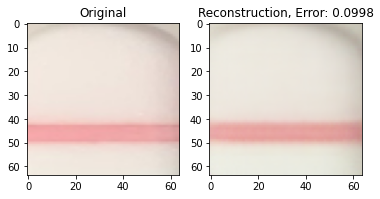

-----------------------------------------------------------------------------


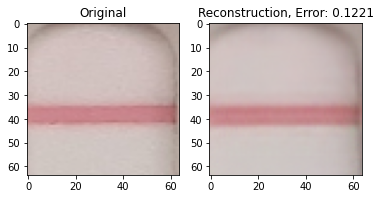

-----------------------------------------------------------------------------


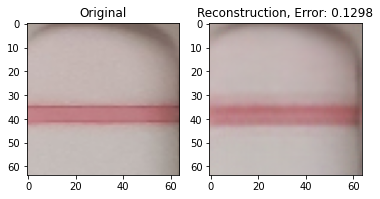

-----------------------------------------------------------------------------


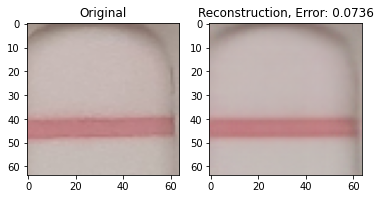

-----------------------------------------------------------------------------


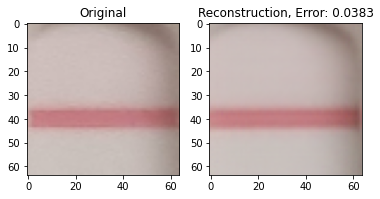

-----------------------------------------------------------------------------


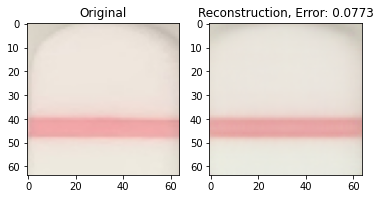

-----------------------------------------------------------------------------


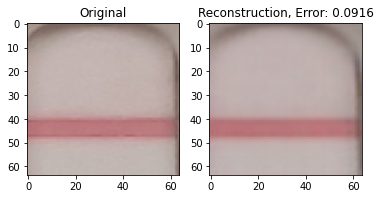

-----------------------------------------------------------------------------


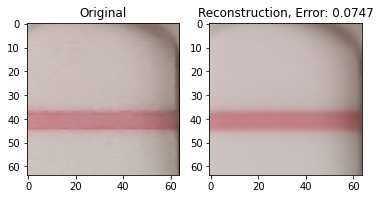

-----------------------------------------------------------------------------


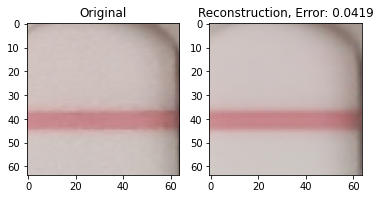

-----------------------------------------------------------------------------


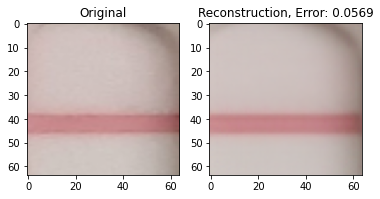

-----------------------------------------------------------------------------


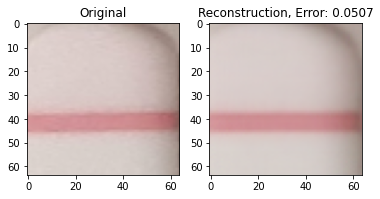

-----------------------------------------------------------------------------


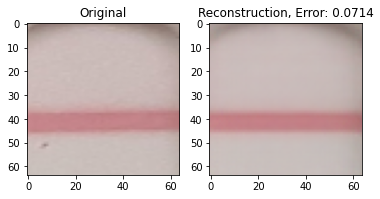

-----------------------------------------------------------------------------


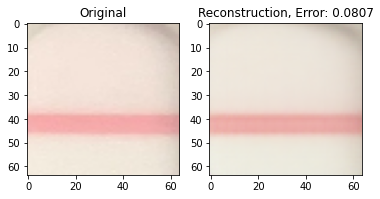

-----------------------------------------------------------------------------


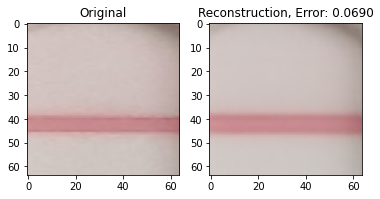

-----------------------------------------------------------------------------


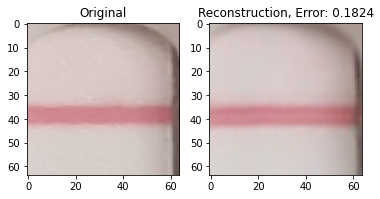

-----------------------------------------------------------------------------


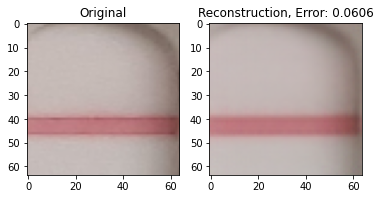

-----------------------------------------------------------------------------


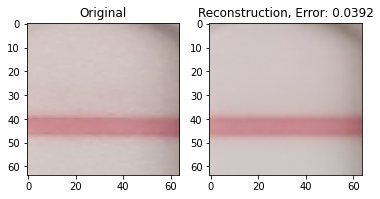

-----------------------------------------------------------------------------


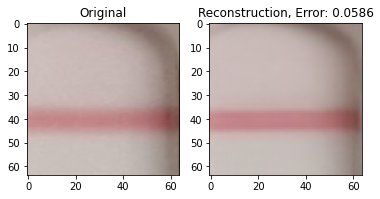

-----------------------------------------------------------------------------


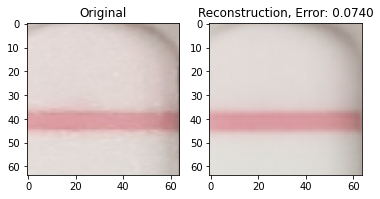

-----------------------------------------------------------------------------


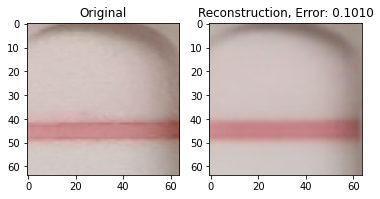

-----------------------------------------------------------------------------


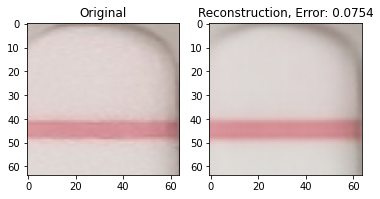

-----------------------------------------------------------------------------


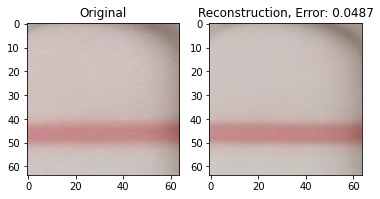

-----------------------------------------------------------------------------


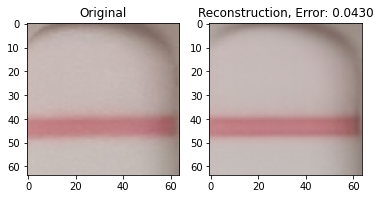

-----------------------------------------------------------------------------


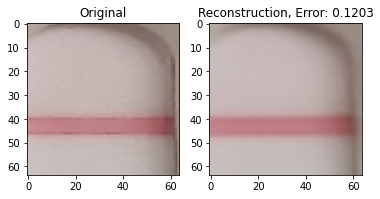

-----------------------------------------------------------------------------


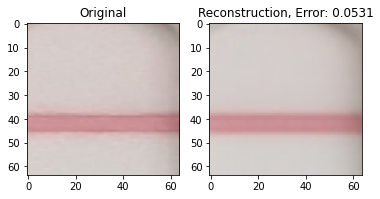

-----------------------------------------------------------------------------


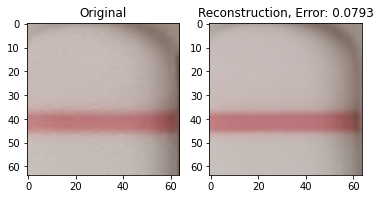

-----------------------------------------------------------------------------


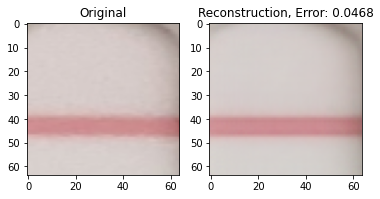

-----------------------------------------------------------------------------


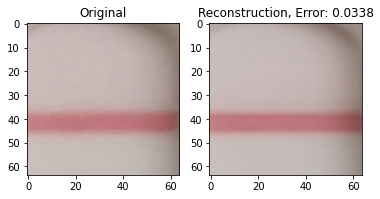

-----------------------------------------------------------------------------


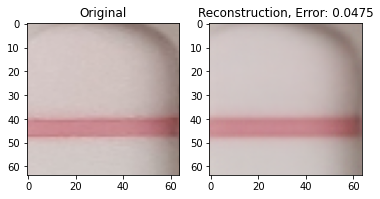

-----------------------------------------------------------------------------


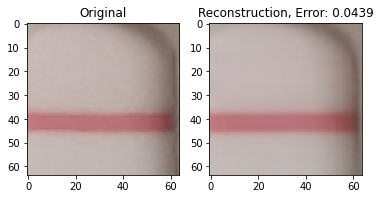

-----------------------------------------------------------------------------


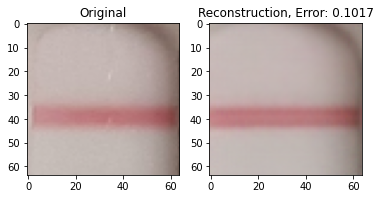

-----------------------------------------------------------------------------


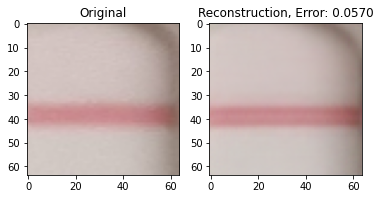

-----------------------------------------------------------------------------


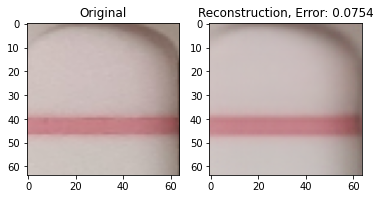

-----------------------------------------------------------------------------


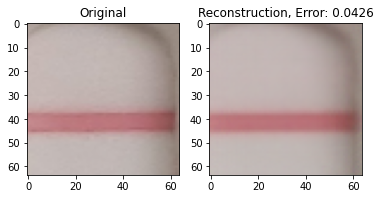

-----------------------------------------------------------------------------


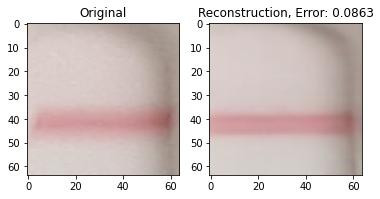

-----------------------------------------------------------------------------


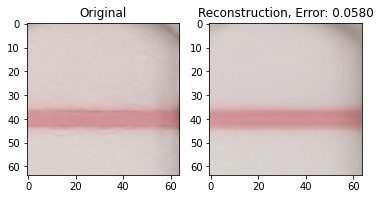

-----------------------------------------------------------------------------


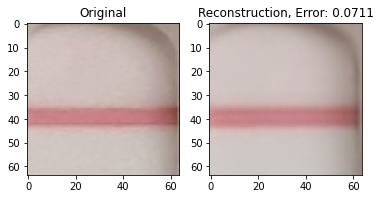

-----------------------------------------------------------------------------


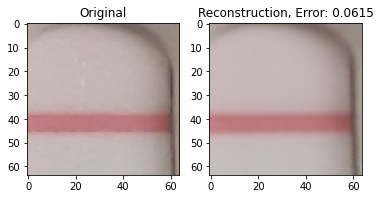

-----------------------------------------------------------------------------


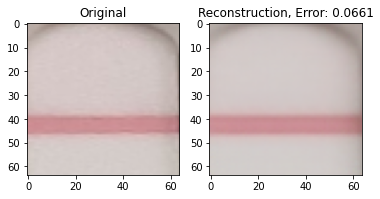

-----------------------------------------------------------------------------


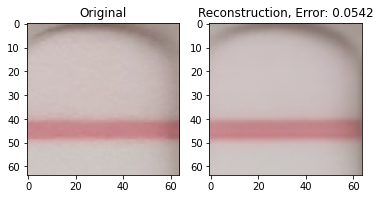

-----------------------------------------------------------------------------


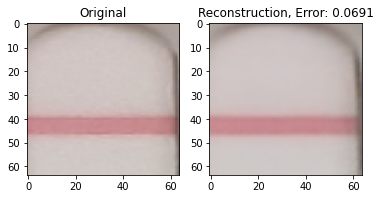

-----------------------------------------------------------------------------


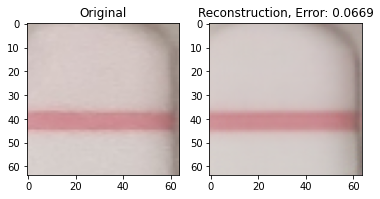

-----------------------------------------------------------------------------


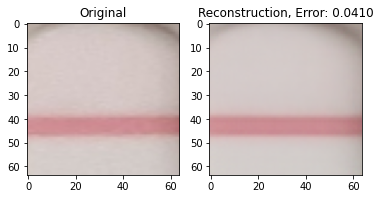

-----------------------------------------------------------------------------


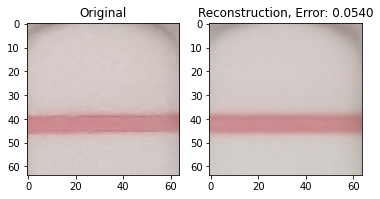

-----------------------------------------------------------------------------


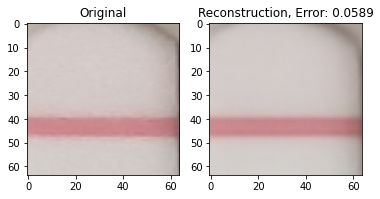

-----------------------------------------------------------------------------


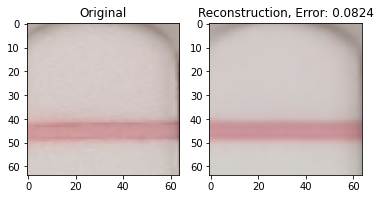

-----------------------------------------------------------------------------


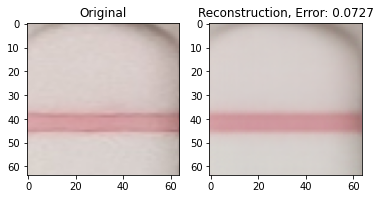

-----------------------------------------------------------------------------


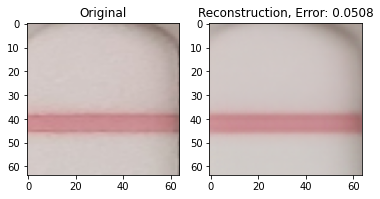

-----------------------------------------------------------------------------


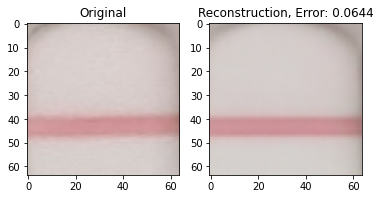

-----------------------------------------------------------------------------


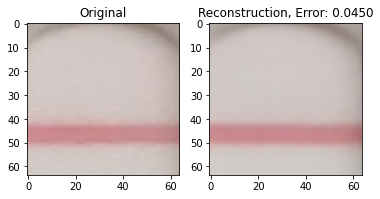

-----------------------------------------------------------------------------


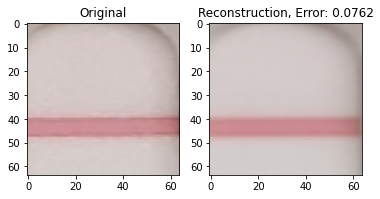

-----------------------------------------------------------------------------


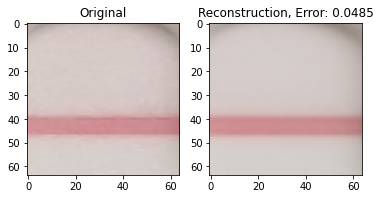

-----------------------------------------------------------------------------


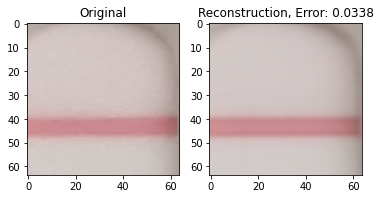

-----------------------------------------------------------------------------


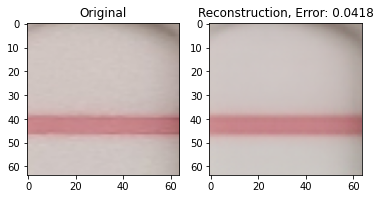

-----------------------------------------------------------------------------


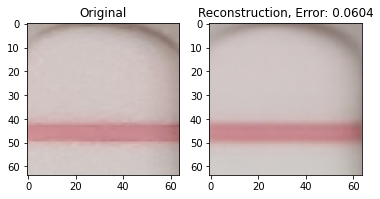

-----------------------------------------------------------------------------


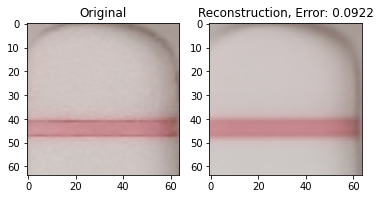

-----------------------------------------------------------------------------


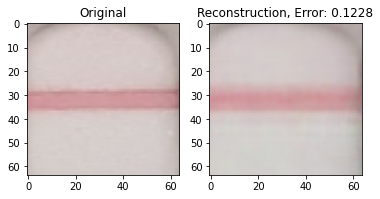

-----------------------------------------------------------------------------


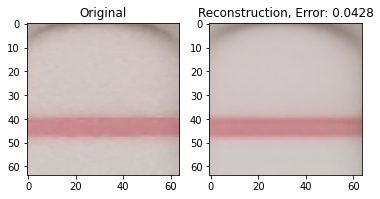

-----------------------------------------------------------------------------


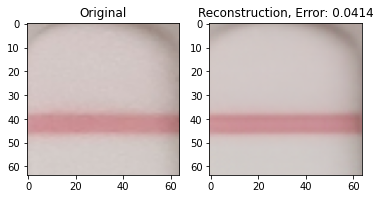

-----------------------------------------------------------------------------


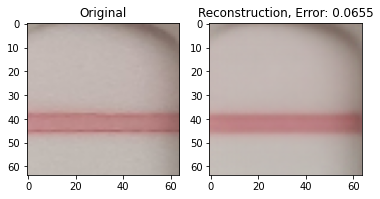

-----------------------------------------------------------------------------


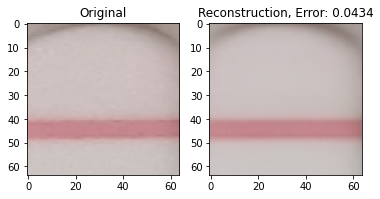

-----------------------------------------------------------------------------


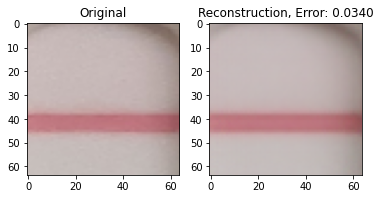

-----------------------------------------------------------------------------


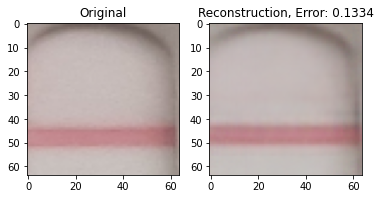

-----------------------------------------------------------------------------


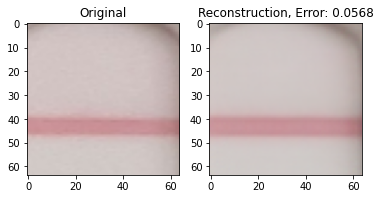

-----------------------------------------------------------------------------


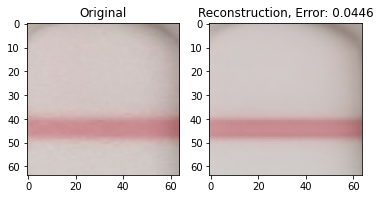

-----------------------------------------------------------------------------


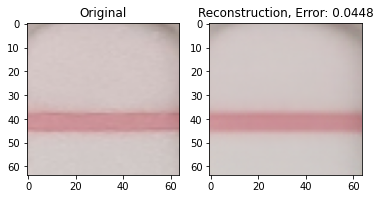

-----------------------------------------------------------------------------


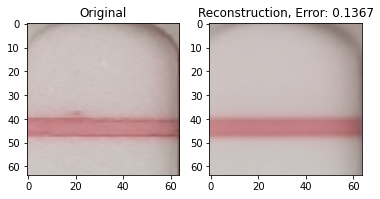

-----------------------------------------------------------------------------


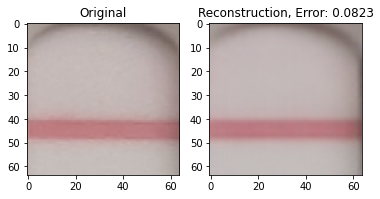

-----------------------------------------------------------------------------


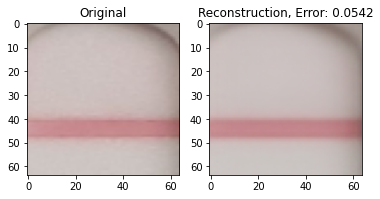

-----------------------------------------------------------------------------


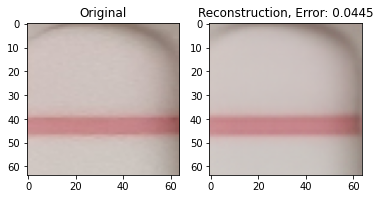

-----------------------------------------------------------------------------


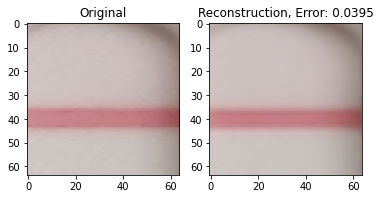

-----------------------------------------------------------------------------


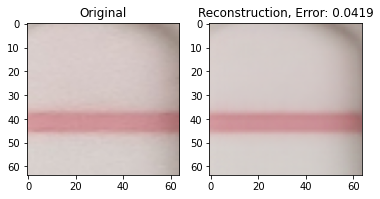

-----------------------------------------------------------------------------


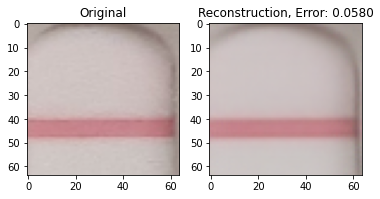

-----------------------------------------------------------------------------


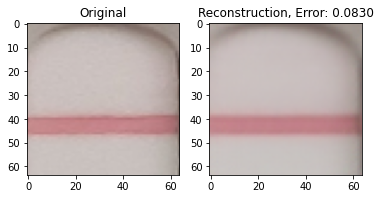

-----------------------------------------------------------------------------


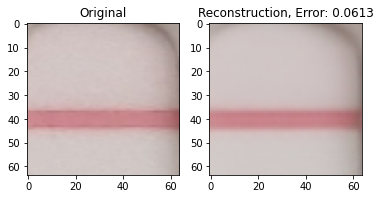

-----------------------------------------------------------------------------


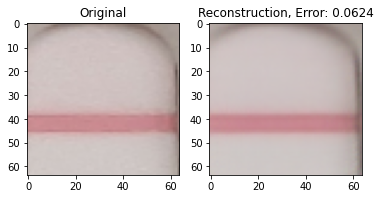

-----------------------------------------------------------------------------


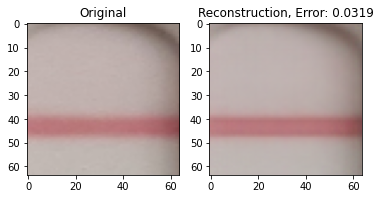

-----------------------------------------------------------------------------


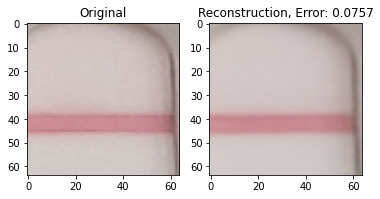

-----------------------------------------------------------------------------


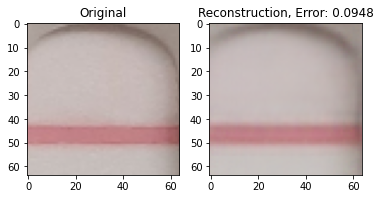

-----------------------------------------------------------------------------


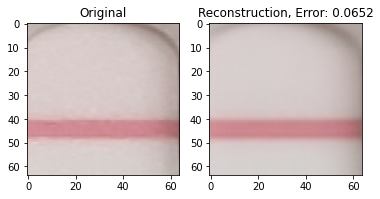

-----------------------------------------------------------------------------


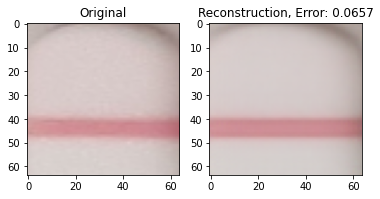

-----------------------------------------------------------------------------


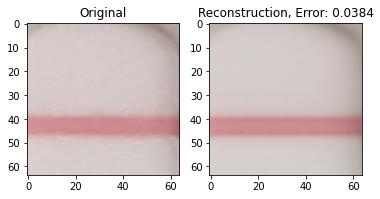

-----------------------------------------------------------------------------


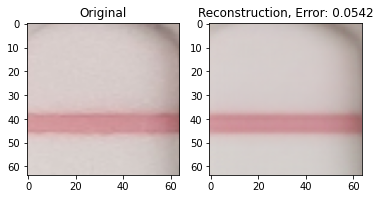

-----------------------------------------------------------------------------


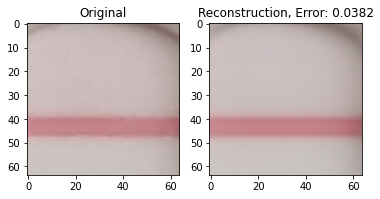

-----------------------------------------------------------------------------


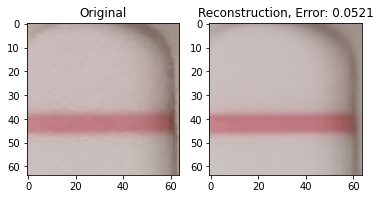

-----------------------------------------------------------------------------


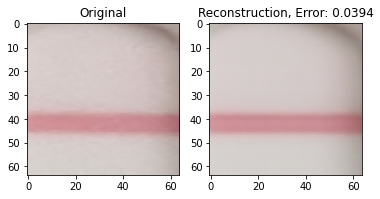

-----------------------------------------------------------------------------


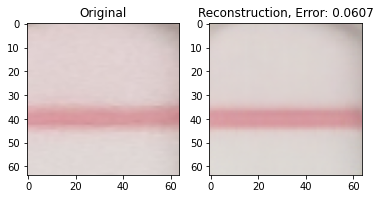

-----------------------------------------------------------------------------


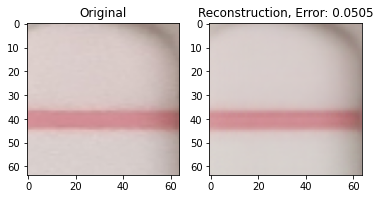

-----------------------------------------------------------------------------


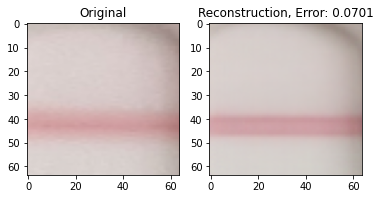

-----------------------------------------------------------------------------


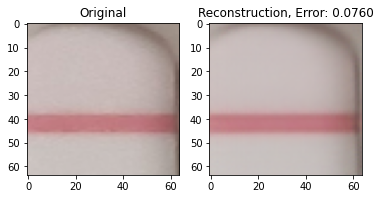

-----------------------------------------------------------------------------


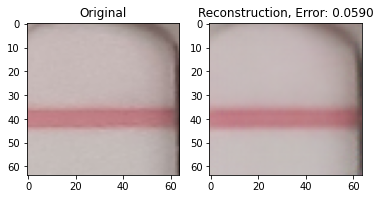

-----------------------------------------------------------------------------


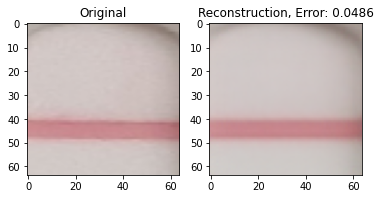

-----------------------------------------------------------------------------


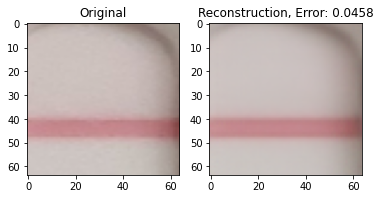

-----------------------------------------------------------------------------


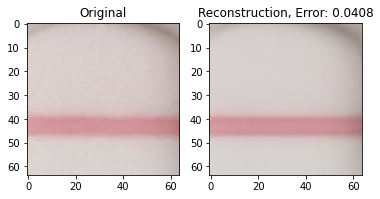

-----------------------------------------------------------------------------


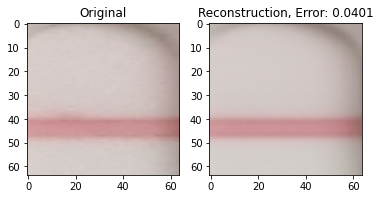

-----------------------------------------------------------------------------


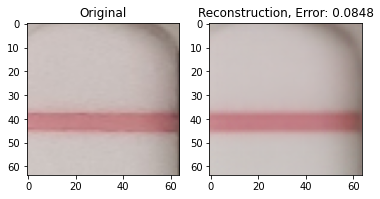

-----------------------------------------------------------------------------


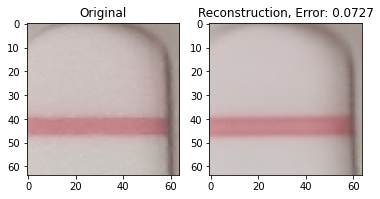

-----------------------------------------------------------------------------


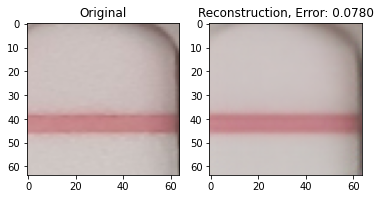

-----------------------------------------------------------------------------


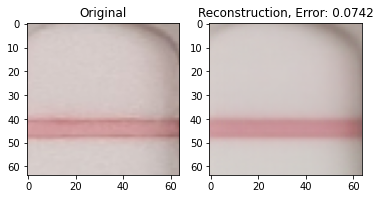

-----------------------------------------------------------------------------


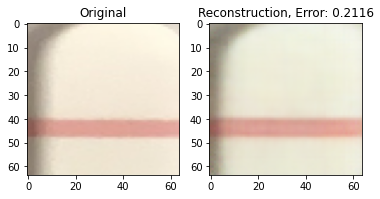

-----------------------------------------------------------------------------


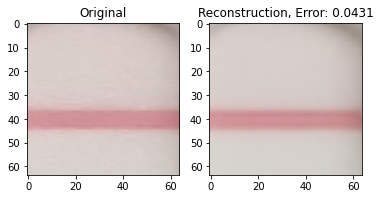

-----------------------------------------------------------------------------


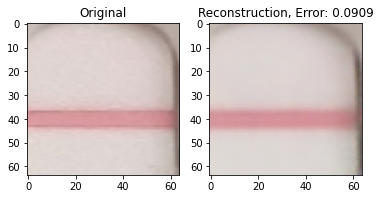

-----------------------------------------------------------------------------


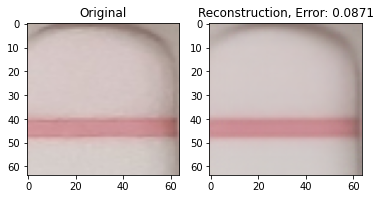

-----------------------------------------------------------------------------


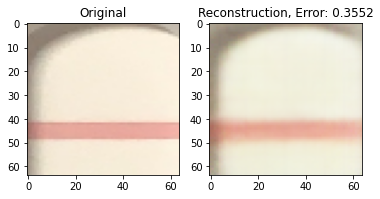

-----------------------------------------------------------------------------


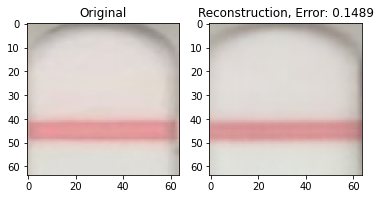

-----------------------------------------------------------------------------


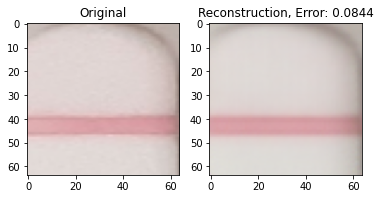

-----------------------------------------------------------------------------


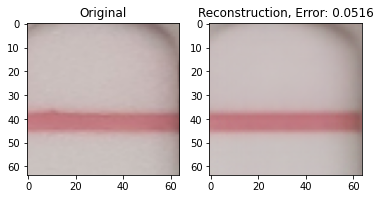

-----------------------------------------------------------------------------


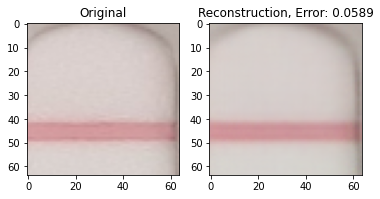

-----------------------------------------------------------------------------


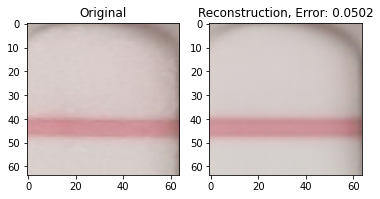

-----------------------------------------------------------------------------


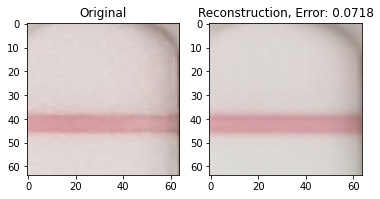

-----------------------------------------------------------------------------


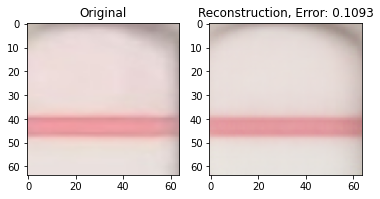

-----------------------------------------------------------------------------


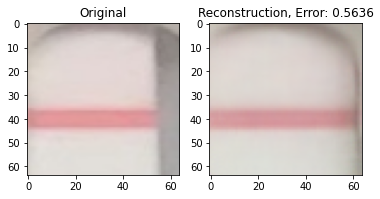

-----------------------------------------------------------------------------


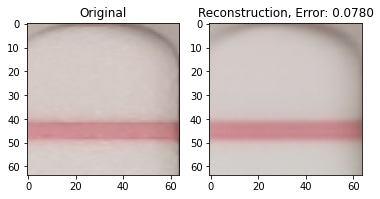

-----------------------------------------------------------------------------


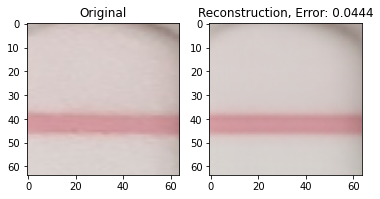

-----------------------------------------------------------------------------


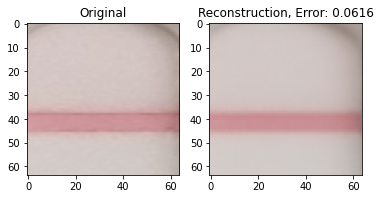

-----------------------------------------------------------------------------


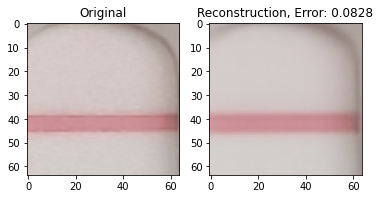

-----------------------------------------------------------------------------


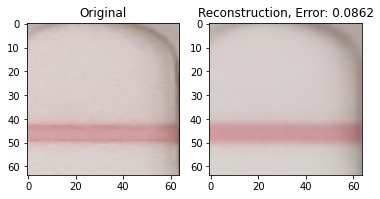

-----------------------------------------------------------------------------


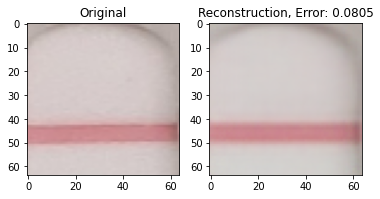

-----------------------------------------------------------------------------


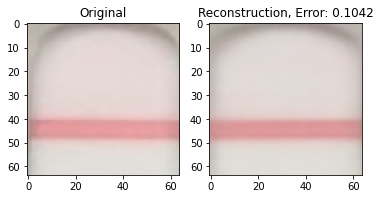

-----------------------------------------------------------------------------


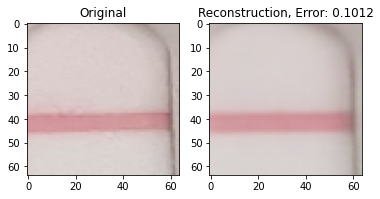

-----------------------------------------------------------------------------


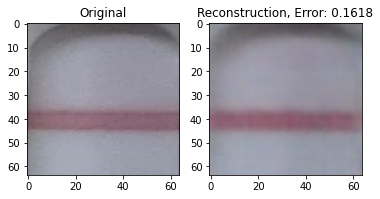

-----------------------------------------------------------------------------


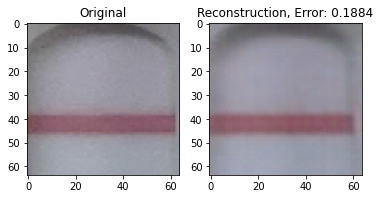

-----------------------------------------------------------------------------


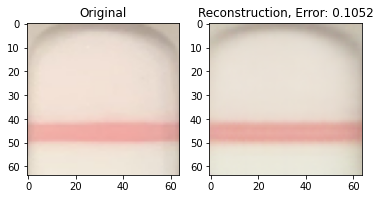

-----------------------------------------------------------------------------


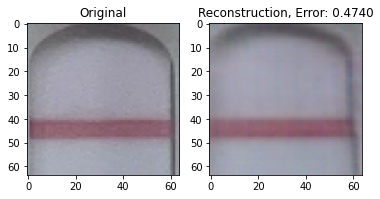

-----------------------------------------------------------------------------


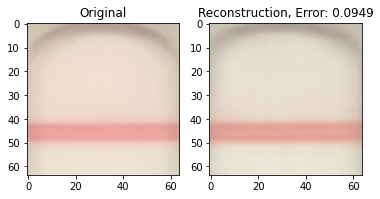

-----------------------------------------------------------------------------


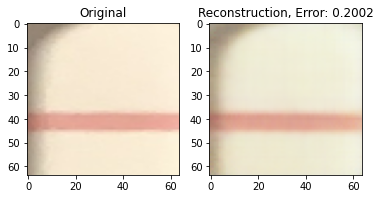

-----------------------------------------------------------------------------


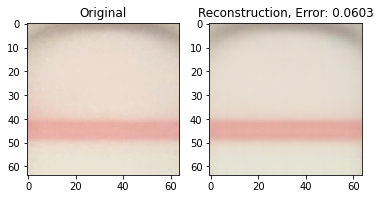

-----------------------------------------------------------------------------


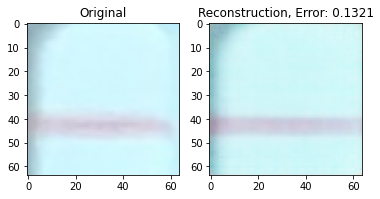

-----------------------------------------------------------------------------


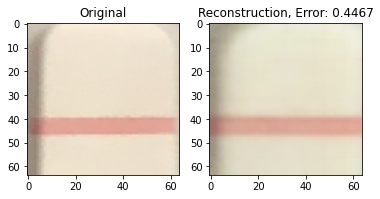

-----------------------------------------------------------------------------


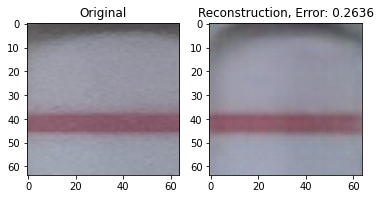

-----------------------------------------------------------------------------


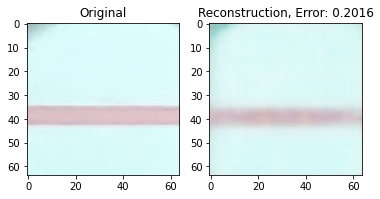

-----------------------------------------------------------------------------


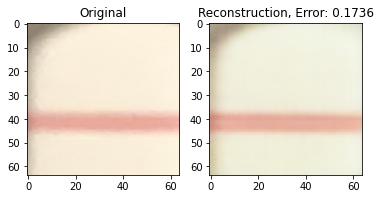

-----------------------------------------------------------------------------


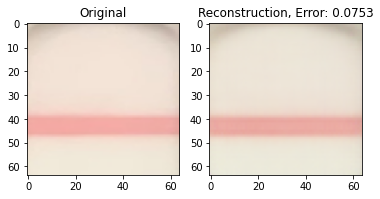

-----------------------------------------------------------------------------


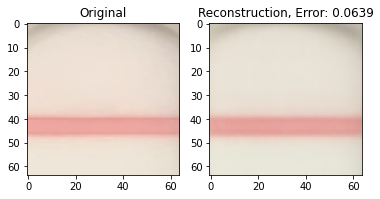

-----------------------------------------------------------------------------


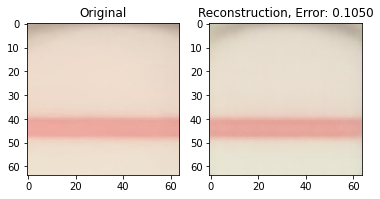

-----------------------------------------------------------------------------


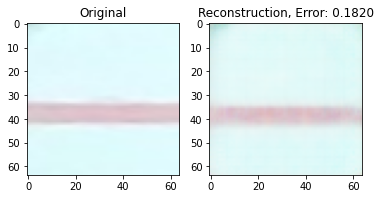

-----------------------------------------------------------------------------


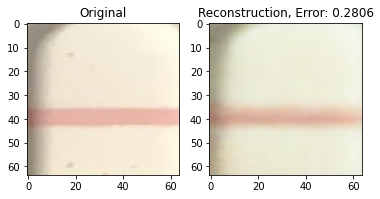

-----------------------------------------------------------------------------


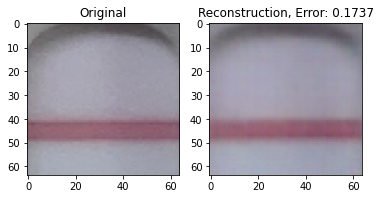

-----------------------------------------------------------------------------


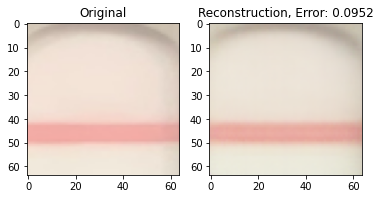

-----------------------------------------------------------------------------


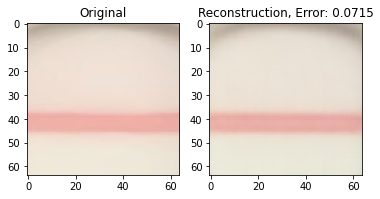

-----------------------------------------------------------------------------


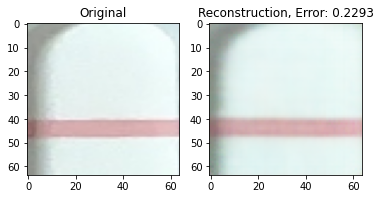

-----------------------------------------------------------------------------


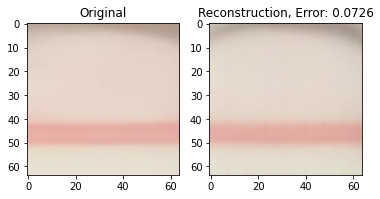

-----------------------------------------------------------------------------


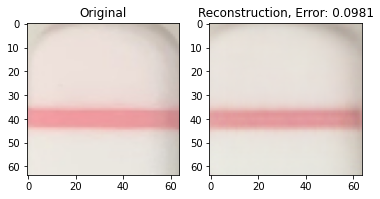

-----------------------------------------------------------------------------


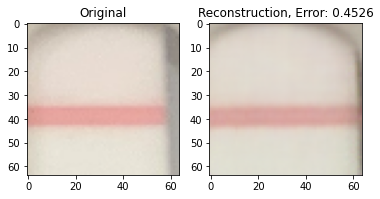

-----------------------------------------------------------------------------


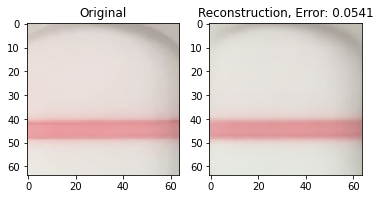

-----------------------------------------------------------------------------


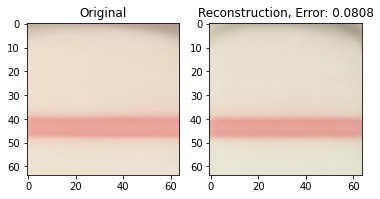

-----------------------------------------------------------------------------


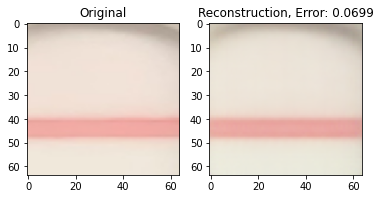

-----------------------------------------------------------------------------


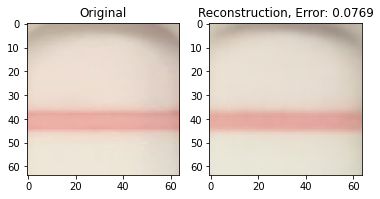

-----------------------------------------------------------------------------


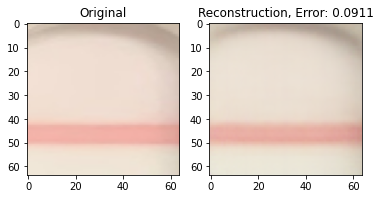

-----------------------------------------------------------------------------


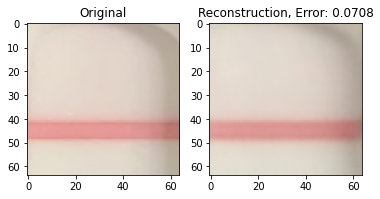

-----------------------------------------------------------------------------


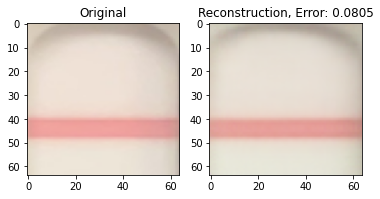

-----------------------------------------------------------------------------


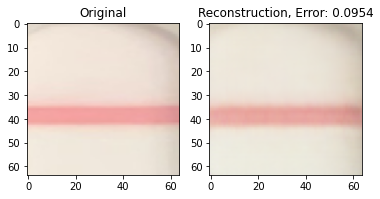

-----------------------------------------------------------------------------


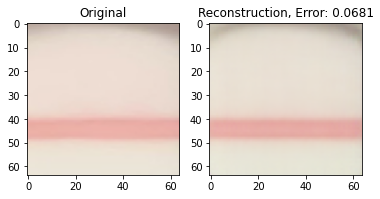

-----------------------------------------------------------------------------


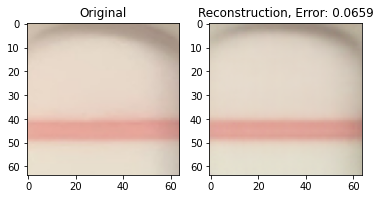

-----------------------------------------------------------------------------


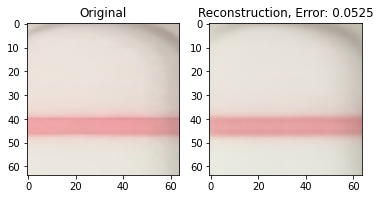

-----------------------------------------------------------------------------


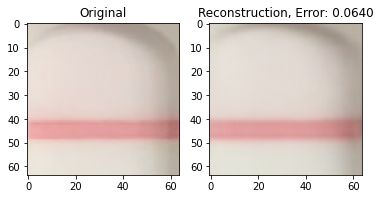

-----------------------------------------------------------------------------


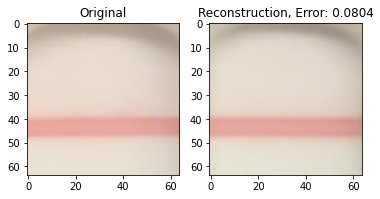

-----------------------------------------------------------------------------


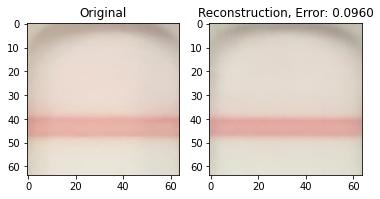

-----------------------------------------------------------------------------


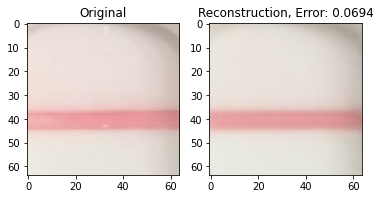

-----------------------------------------------------------------------------


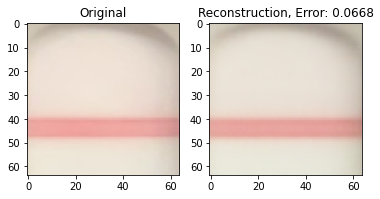

-----------------------------------------------------------------------------


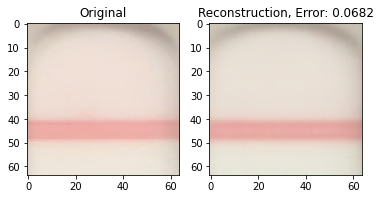

-----------------------------------------------------------------------------


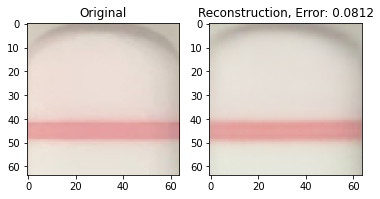

-----------------------------------------------------------------------------


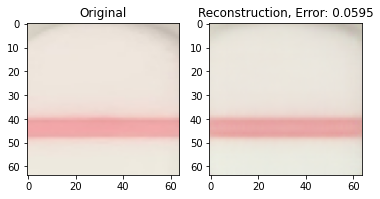

-----------------------------------------------------------------------------


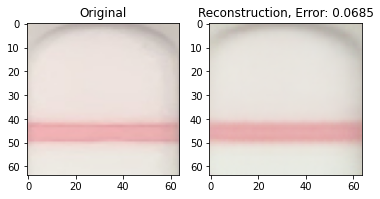

-----------------------------------------------------------------------------


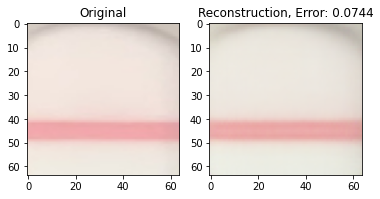

-----------------------------------------------------------------------------


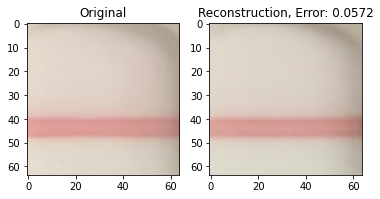

-----------------------------------------------------------------------------


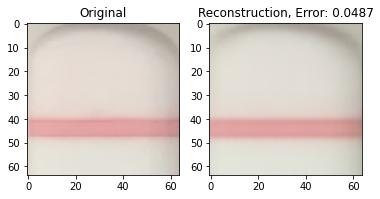

-----------------------------------------------------------------------------


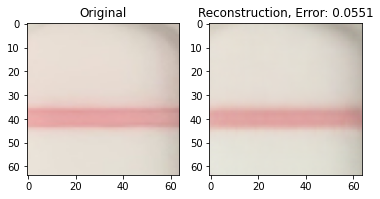

-----------------------------------------------------------------------------


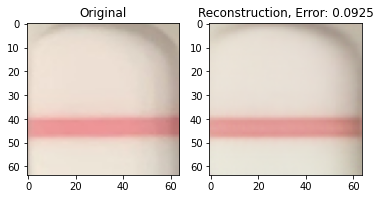

-----------------------------------------------------------------------------


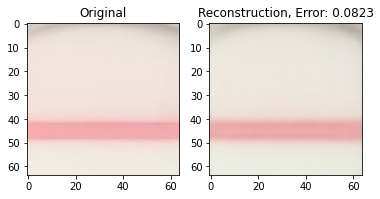

-----------------------------------------------------------------------------


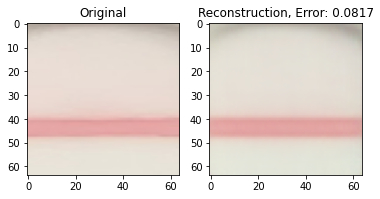

-----------------------------------------------------------------------------


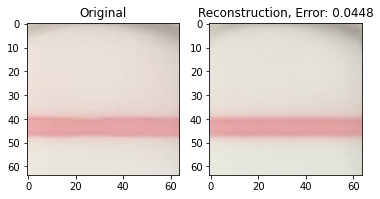

-----------------------------------------------------------------------------


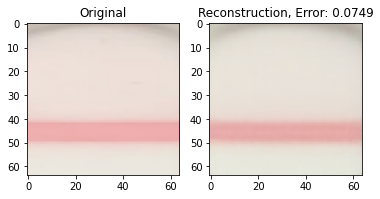

-----------------------------------------------------------------------------


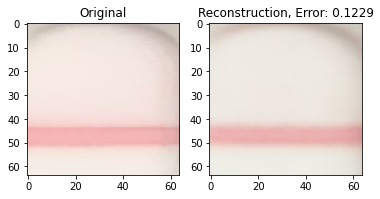

-----------------------------------------------------------------------------


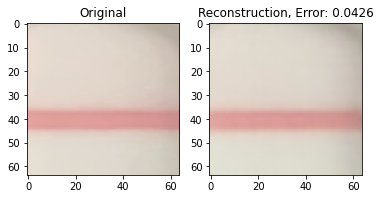

-----------------------------------------------------------------------------


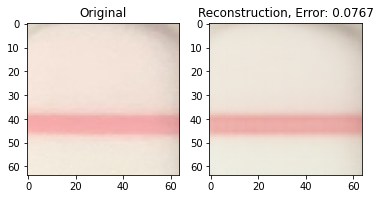

-----------------------------------------------------------------------------


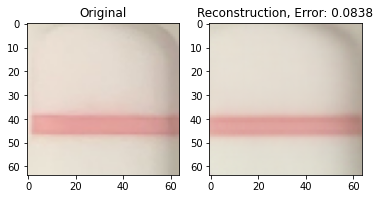

-----------------------------------------------------------------------------


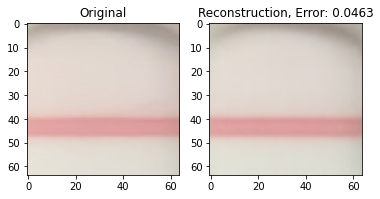

-----------------------------------------------------------------------------


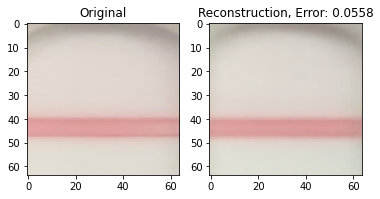

-----------------------------------------------------------------------------


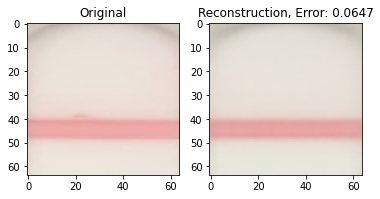

-----------------------------------------------------------------------------


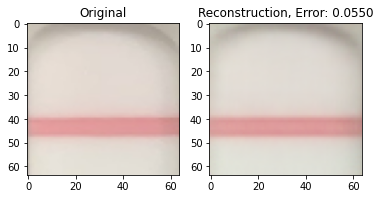

-----------------------------------------------------------------------------


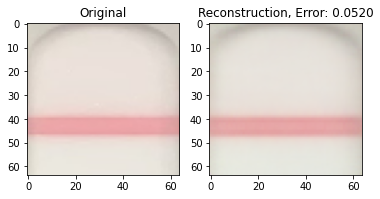

-----------------------------------------------------------------------------


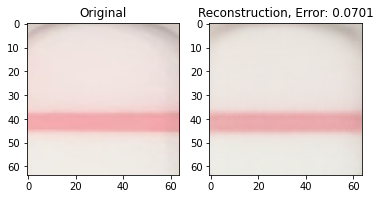

-----------------------------------------------------------------------------


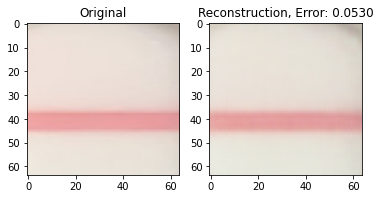

-----------------------------------------------------------------------------


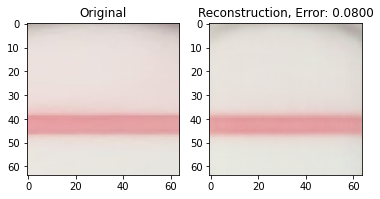

-----------------------------------------------------------------------------


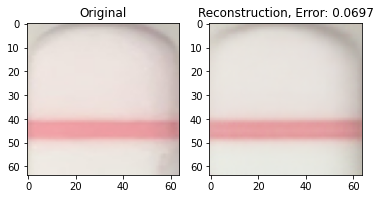

-----------------------------------------------------------------------------


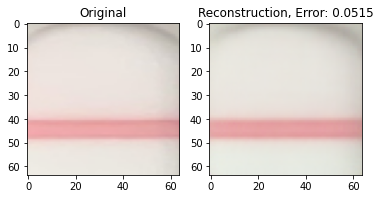

-----------------------------------------------------------------------------


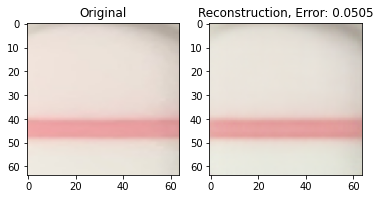

-----------------------------------------------------------------------------


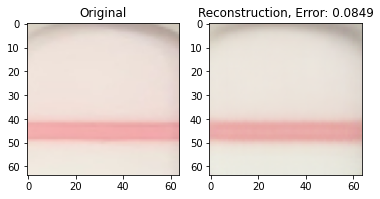

-----------------------------------------------------------------------------


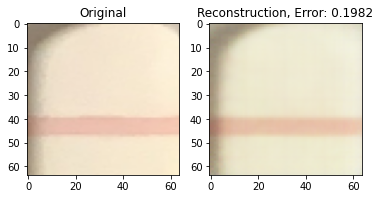

-----------------------------------------------------------------------------


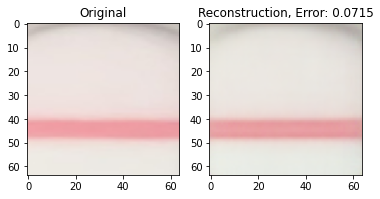

-----------------------------------------------------------------------------


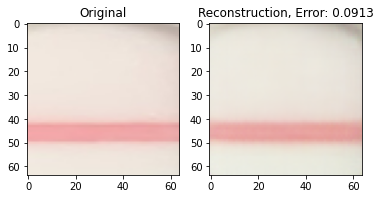

-----------------------------------------------------------------------------


In [ ]:
from losses import reconstruction_loss
test_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False)

for i, batch in enumerate(test_loader):
  x, y = batch
  # x = x.view(x.shape[0], -1)
   
  x_hat, mu, logvar = model(x)
  x_hat[x_hat < 0.] = 0.

  # loss = reconstruction_loss(x=x, x_hat=x_hat)
  loss = model.loss_function(x=x, x_hat=x_hat, mu=mu, logvar=logvar)

  x = x[0].view(NUM_CHANNELS, IMG_SIZE, IMG_SIZE)
  x_hat = x_hat[0].view(NUM_CHANNELS, IMG_SIZE, IMG_SIZE)
  
  fig, ax = plt.subplots(1, 2)
  ax[0].imshow(x[:, :, :].cpu().detach().permute(1,2,0))
  ax[0].set_title('Original')
  ax[1].imshow(x_hat[:, :, :].cpu().detach().permute(1,2,0))
  ax[1].set_title('Reconstruction, Error: %0.4f' % loss.item())
  plt.show()
  print('-----------------------------------------------------------------------------')

Picked Threshold: 1.50
Separation: 0.2581
Accuracy: 1.0000
Num Correct:  366
Num Wrong:  0


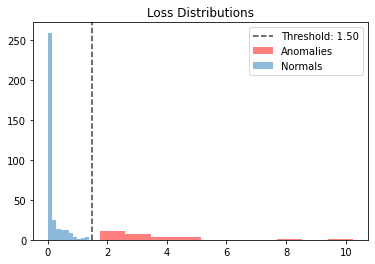

In [ ]:
from losses import reconstruction_loss
ANOMALY_IMAGES, NORMAL_IMAGES = [], []
ANOMALY_LOSSES, NORMAL_LOSSES = [], []

test_plus_invalid_dataset = ConcatDataset([test_dataset, invalid_dataset])
test_plus_invalid_loader = DataLoader(dataset=test_plus_invalid_dataset, batch_size=1, shuffle=False)

model.eval()
with torch.no_grad():
  for batch in test_plus_invalid_loader:
    x, y = batch
    # x = x.view(x.shape[0], -1)
   
    x_hat, mu, logvar = model(x)
    x_hat[x_hat < 0.] = 0.
    x_hat[x_hat > 1.] = 1.
    
    # loss = reconstruction_loss(x=x, x_hat=x_hat)
    loss = model.loss_function(x=x, x_hat=x_hat, mu=mu, logvar=logvar)
    # loss = F.mse_loss(x_hat, x)
    
    x = x[0].view(NUM_CHANNELS, IMG_SIZE, IMG_SIZE)
    x_hat = x_hat[0].view(NUM_CHANNELS, IMG_SIZE, IMG_SIZE)

    if y.item() == 1:
      ANOMALY_IMAGES.append(x.cpu().detach().permute(1,2,0))
      ANOMALY_LOSSES.append(loss.item())
    else:
      NORMAL_IMAGES.append(x.cpu().detach().permute(1,2,0))
      NORMAL_LOSSES.append(loss.item())

# print('MIN ANOMALY LOSS: ', min(ANOMALY_LOSSES))
# print('MIN NORMAL LOSS: ', min(NORMAL_LOSSES))
# print('MAX ANOMALY LOSS: ', max(ANOMALY_LOSSES))
# print('MAX NORMAL LOSS: ', max(NORMAL_LOSSES))

# if min(ANOMALY_LOSSES) > max(NORMAL_LOSSES):
	# print('SUCCESS!')
# else:
	# print('KEEP TRYING!')
 
# threshold = min(ANOMALY_LOSSES)
threshold = max(NORMAL_LOSSES) + 0.12
print('Picked Threshold: %0.2f' % threshold)
print('Separation: %0.4f' % abs(threshold - min(ANOMALY_LOSSES)))
num_total = len(ANOMALY_LOSSES) + len(NORMAL_LOSSES)
num_correct = len([l for l in ANOMALY_LOSSES if l >= threshold]) + len([l for l in NORMAL_LOSSES if l < threshold])
print('Accuracy: %0.4f' % (num_correct / num_total))
print('Num Correct: ', num_correct)
print('Num Wrong: ', num_total - num_correct)

plt.hist(ANOMALY_LOSSES, alpha=0.5, color='red', label='Anomalies')
plt.hist(NORMAL_LOSSES, alpha=0.5, label='Normals')
plt.axvline(threshold, color='black', alpha=0.75, linestyle='--', label='Threshold: %0.2f' % threshold)
plt.legend(loc='upper right')
plt.title('Loss Distributions')
plt.savefig('loss_distributions.png')
plt.show()

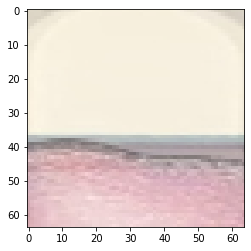

In [ ]:
for i in range(len(ANOMALY_LOSSES)):
  if ANOMALY_LOSSES[i] < threshold:
    plt.imshow(ANOMALY_IMAGES[i])
    plt.show()

for i in range(len(NORMAL_LOSSES)):
  if NORMAL_LOSSES[i] >= threshold:
    plt.imshow(NORMAL_IMAGES[i])
    plt.show()

MIN ANOMALY LOSS:  0.14573346524390562
MIN NORMAL LOSS:  0.010011902030099051
MAX ANOMALY LOSS:  0.3385885857968183
MAX NORMAL LOSS:  0.142219832978983
SUCCESS!


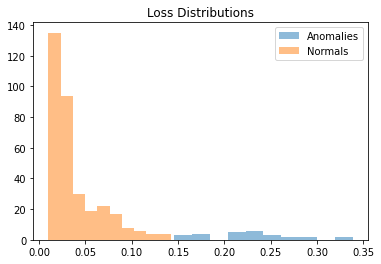

In [ ]:
from losses import reconstruction_loss
from skimage.metrics import structural_similarity as ssim
ANOMALY_LOSSES, NORMAL_LOSSES = [], []

test_plus_invalid_dataset = ConcatDataset([test_dataset, invalid_dataset])
test_plus_invalid_loader = DataLoader(dataset=test_plus_invalid_dataset, batch_size=1, shuffle=False)

with torch.no_grad():
  for batch in test_plus_invalid_loader:
    x, y = batch
    # x = x.view(x.shape[0], -1)
   
    x_hat, mu, logvar = model(x)
    x_hat[x_hat < 0.] = 0.
    
    x = x[0].view(NUM_CHANNELS, IMG_SIZE, IMG_SIZE)
    x_hat = x_hat[0].view(NUM_CHANNELS, IMG_SIZE, IMG_SIZE)

    loss = 1.0 - ssim(x.cpu().detach().permute(1, 2, 0).numpy(), x_hat.cpu().detach().permute(1, 2, 0).numpy(), multichannel=True)
    if y.item() == 1:
      ANOMALY_LOSSES.append(loss.item())
    else:
      NORMAL_LOSSES.append(loss.item())

print('MIN ANOMALY LOSS: ', min(ANOMALY_LOSSES))
print('MIN NORMAL LOSS: ', min(NORMAL_LOSSES))
print('MAX ANOMALY LOSS: ', max(ANOMALY_LOSSES))
print('MAX NORMAL LOSS: ', max(NORMAL_LOSSES))

if min(ANOMALY_LOSSES) > max(NORMAL_LOSSES):
	print('SUCCESS!')
else:
	print('KEEP TRYING!')

plt.hist(ANOMALY_LOSSES, alpha=0.5, label='Anomalies')
plt.hist(NORMAL_LOSSES, alpha=0.5, label='Normals')
plt.legend(loc='upper right')
plt.title('Loss Distributions')
plt.savefig('loss_distributions.png')
plt.show()

Accuracy: 0.9891
Num Correct:  362
Num Wrong:  4


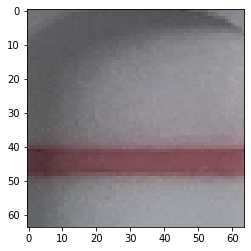

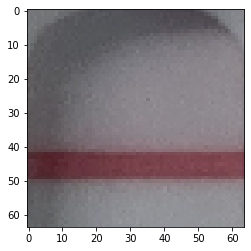

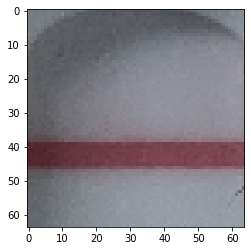

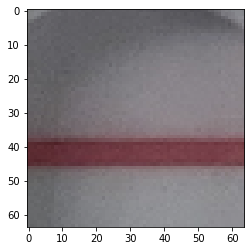

In [ ]:
threshold = min(ANOMALY_LOSSES)
num_total = len(ANOMALY_LOSSES) + len(NORMAL_LOSSES)
num_correct = len([l for l in ANOMALY_LOSSES if l >= threshold]) + len([l for l in NORMAL_LOSSES if l < threshold])
print('Accuracy: %0.4f' % (num_correct / num_total))
print('Num Correct: ', num_correct)
print('Num Wrong: ', num_total - num_correct)

for i in range(len(ANOMALY_LOSSES)):
  if ANOMALY_LOSSES[i] < threshold:
    plt.imshow(ANOMALY_IMAGES[i])
    plt.show()

for i in range(len(NORMAL_LOSSES)):
  if NORMAL_LOSSES[i] >= threshold:
    plt.imshow(NORMAL_IMAGES[i])
    plt.show()

In [ ]:
def center_crop(im):
  new_width, new_height = IMG_SIZE, IMG_SIZE
  width, height = im.size   # Get dimensions

  left = (width - new_width)/2
  top = (height - new_height)/2
  right = (width + new_width)/2
  bottom = (height + new_height)/2

  # Crop the center of the image
  im = im.crop((left, top, right, bottom))
  return im

In [ ]:
from losses import reconstruction_loss
import imagehash
from PIL import Image
ANOMALY_LOSSES, NORMAL_LOSSES = [], []

test_plus_invalid_dataset = ConcatDataset([test_dataset, invalid_dataset])
test_plus_invalid_loader = DataLoader(dataset=test_plus_invalid_dataset, batch_size=1, shuffle=False)

with torch.no_grad():
  for batch in test_plus_invalid_loader:
    x, y = batch
    # x = x.view(x.shape[0], -1)
   
    x_hat, mu, logvar = model(x)
    x_hat[x_hat < 0.] = 0.
    
    x = x[0].view(NUM_CHANNELS, IMG_SIZE, IMG_SIZE)
    x_hat = x_hat[0].view(NUM_CHANNELS, IMG_SIZE, IMG_SIZE)

    hash0 = imagehash.average_hash(center_crop(Image.fromarray(np.uint8(x.cpu().detach().permute(1, 2, 0).numpy()*255))))
    hash1 = imagehash.average_hash(center_crop(Image.fromarray(np.uint8(x_hat.cpu().detach().permute(1, 2, 0).numpy()*255))))
    loss = abs(hash1 - hash0)
    if y.item() == 1:
      ANOMALY_LOSSES.append(loss)
    else:
      NORMAL_LOSSES.append(loss)

print('MIN ANOMALY LOSS: ', min(ANOMALY_LOSSES))
print('MIN NORMAL LOSS: ', min(NORMAL_LOSSES))
print('MAX ANOMALY LOSS: ', max(ANOMALY_LOSSES))
print('MAX NORMAL LOSS: ', max(NORMAL_LOSSES))

if min(ANOMALY_LOSSES) > max(NORMAL_LOSSES):
	print('SUCCESS!')
else:
	print('KEEP TRYING!')

plt.hist(ANOMALY_LOSSES, alpha=0.5, label='Anomalies')
plt.hist(NORMAL_LOSSES, alpha=0.5, label='Normals')
plt.legend(loc='upper right')
plt.title('Loss Distributions')
plt.savefig('loss_distributions.png')
plt.show()

ModuleNotFoundError: ignored

In [ ]:
threshold = min(ANOMALY_LOSSES)
num_total = len(ANOMALY_LOSSES) + len(NORMAL_LOSSES)
num_correct = len([l for l in ANOMALY_LOSSES if l >= threshold]) + len([l for l in NORMAL_LOSSES if l < threshold])
print('Accuracy: %0.4f' % (num_correct / num_total))
print('Num Correct: ', num_correct)
print('Num Wrong: ', num_total - num_correct)

for i in range(len(ANOMALY_LOSSES)):
  if ANOMALY_LOSSES[i] < threshold:
    plt.imshow(ANOMALY_IMAGES[i])
    plt.show()

for i in range(len(NORMAL_LOSSES)):
  if NORMAL_LOSSES[i] >= threshold:
    plt.imshow(NORMAL_IMAGES[i])
    plt.show()

In [ ]:
z = torch.randn(size=(20, LATENT_DIM)).to(DEVICE)
x_hat = model.decode(z)
x_hat[x_hat < 0.] = 0
x_hat = x_hat.view(20, NUM_CHANNELS, IMG_SIZE, IMG_SIZE)
fig, ax = plt.subplots(nrows=5, ncols=4, figsize=(10, 10))
for i in range(5):
  for j in range(4):
    image = x_hat[(i+1)*(j+1)-1, :, :, :].cpu().detach().permute(1,2,0).numpy()
    # image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    ax[i][j].imshow(image)

plt.savefig('samples.png')
plt.show()

In [ ]:
z = torch.randn(size=(20, LATENT_DIM)).to(DEVICE)
x_hat = model.decode(z)
x_hat[x_hat < 0.] = 0
x_hat = x_hat.view(20, NUM_CHANNELS, IMG_SIZE, IMG_SIZE)
fig, ax = plt.subplots(nrows=5, ncols=4, figsize=(10, 10))
for i in range(5):
  for j in range(4):
    image = x_hat[(i+1)*(j+1)-1, :, :, :].cpu().detach().permute(1,2,0).numpy()
    # image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    ax[i][j].imshow(image)

plt.savefig('samples.png')
plt.show()

SyntaxError: ignored

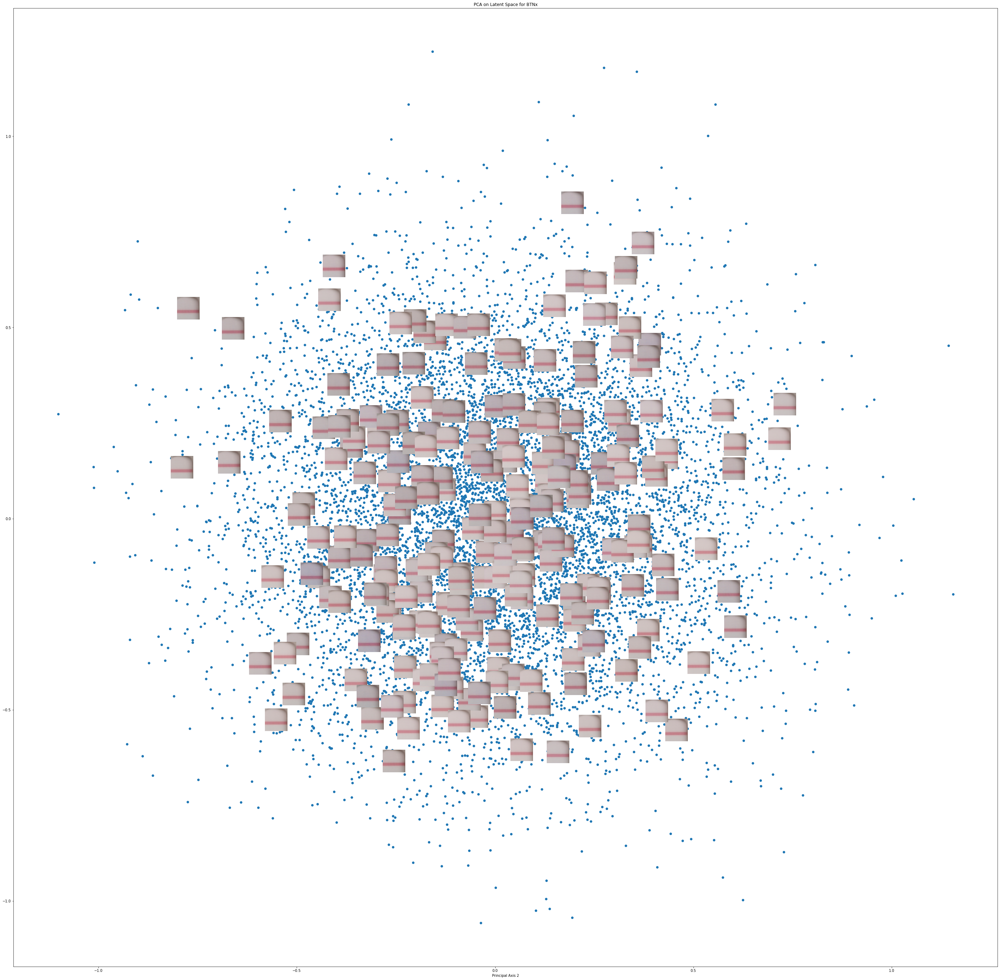

In [ ]:
from sklearn.decomposition import PCA
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
import random

DEVICE = 'cpu'
model.to(DEVICE)
NUM_SAMPLES = 10000
z = torch.rand(NUM_SAMPLES, LATENT_DIM).to(DEVICE)
x_hat = model.decode(z)
x_hat[x_hat < 0.] = 0.
x_hat = x_hat.view(NUM_SAMPLES, NUM_CHANNELS, IMG_SIZE, IMG_SIZE).permute(0, 2, 3, 1)
x_hat = x_hat.cpu().detach().numpy()

pca = PCA(n_components=2)
z_pca = pca.fit_transform(z.cpu().detach().numpy())


fig, ax = plt.subplots(figsize=(50, 50))
ax.scatter(z_pca[:, 0], z_pca[:, 1]) 

idx = random.sample(list(range(NUM_SAMPLES)), 250)
selected_z_pca = z_pca[idx, :]
for x0, y0, i in zip(selected_z_pca[:, 0], selected_z_pca[:, 1], idx):
    ab = AnnotationBbox(OffsetImage(x_hat[i, :, :, :]), (x0, y0), frameon=False)
    ax.add_artist(ab)

ax.set_title('PCA on Latent Space for BTNx')
ax.set_xlabel('Principal Axis 1')
ax.set_xlabel('Principal Axis 2')

plt.savefig('pca_on_ls_btnx.png')

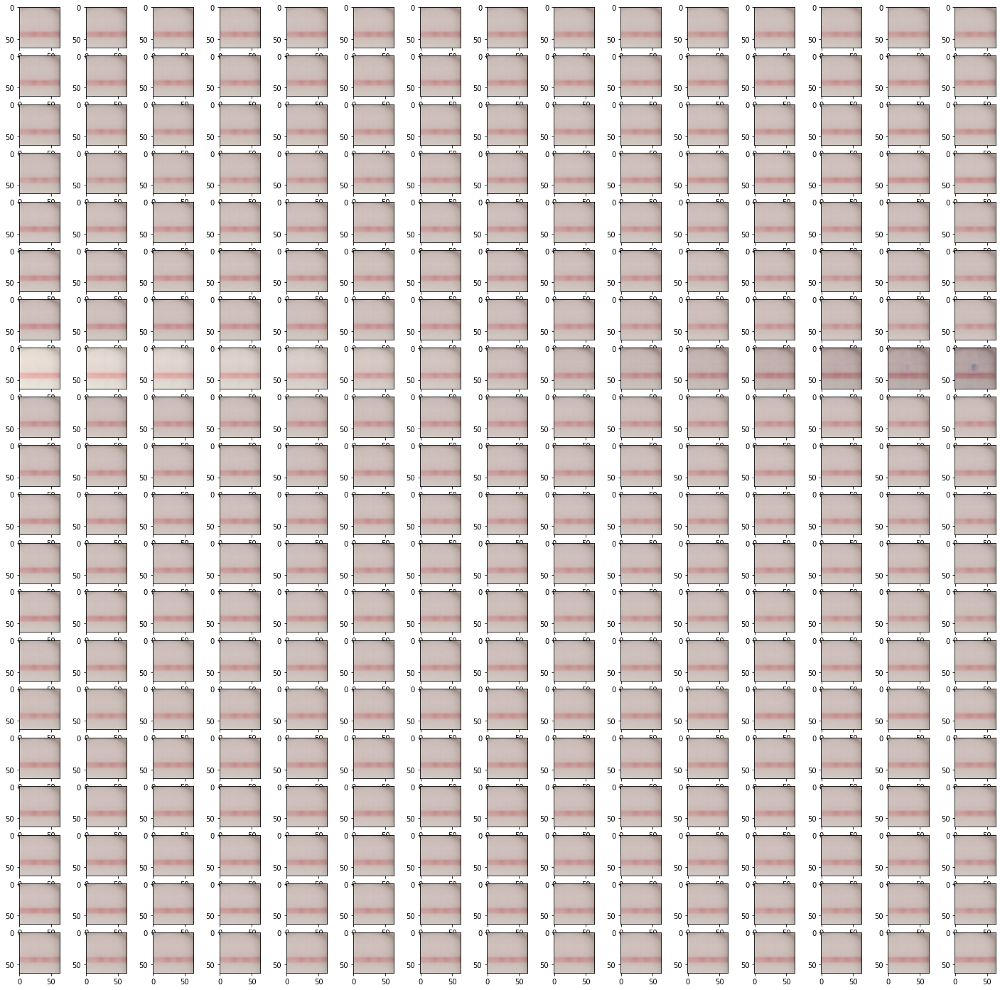

In [ ]:
LATENT_IDX = list(range(LATENT_DIM))[:20]
# LATENT_IDX = [0, 1, 15, 17, 20]
fig, ax = plt.subplots(nrows=len(LATENT_IDX), ncols=15, figsize=(25, 25))
for i, latent_i in enumerate(LATENT_IDX):
    for j, z_i in enumerate(np.linspace(-3.0, 3.0, 15)):
        z = torch.zeros(2, LATENT_DIM).to(DEVICE)
        z[:, latent_i] = z_i
        x_hat = model.decode(z)[0, :]
        x_hat[x_hat < 0.] = 0.
        x_hat = x_hat.view(NUM_CHANNELS, IMG_SIZE, IMG_SIZE)
        image = x_hat[:, :, :].cpu().detach().permute(1,2,0).numpy()
        # image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        ax[i][j].imshow(image)

plt.savefig('latent_space.png')
plt.show()

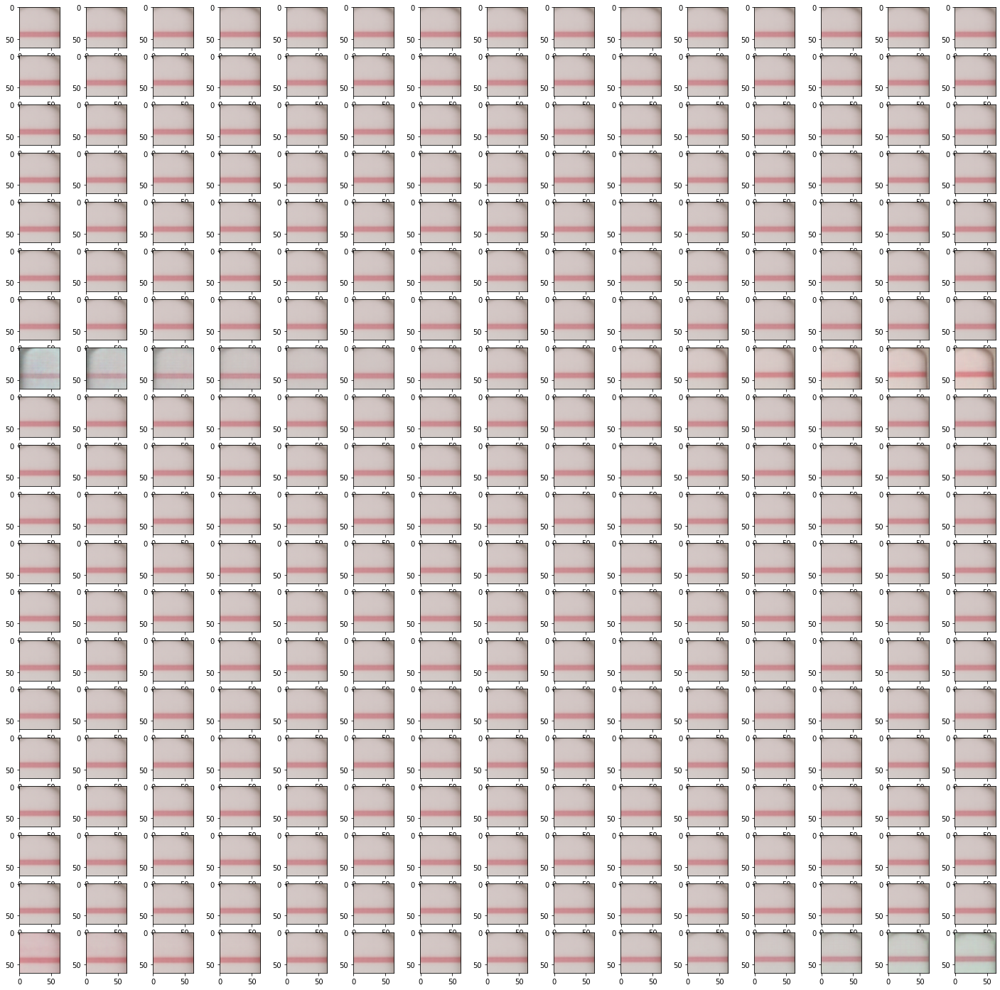

In [ ]:
LATENT_IDX = list(range(LATENT_DIM))[80:100]
# LATENT_IDX = [0, 1, 15, 17, 20]
fig, ax = plt.subplots(nrows=len(LATENT_IDX), ncols=15, figsize=(25, 25))
for i, latent_i in enumerate(LATENT_IDX):
    for j, z_i in enumerate(np.linspace(-3.0, 3.0, 15)):
        z = torch.zeros(2, LATENT_DIM).to(DEVICE)
        z[:, latent_i] = z_i
        x_hat = model.decode(z)[0, :]
        x_hat[x_hat < 0.] = 0.
        x_hat = x_hat.view(NUM_CHANNELS, IMG_SIZE, IMG_SIZE)
        image = x_hat[:, :, :].cpu().detach().permute(1,2,0).numpy()
        # image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        ax[i][j].imshow(image)

plt.savefig('latent_space.png')
plt.show()

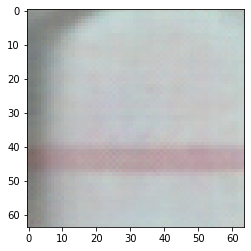

In [ ]:
z = torch.zeros(2, LATENT_DIM).to(DEVICE)
z[:, 87] = -3.0
x_hat = model.decode(z)[0, :]
x_hat[x_hat < 0.] = 0.
x_hat = x_hat.view(NUM_CHANNELS, IMG_SIZE, IMG_SIZE)
image = x_hat[:, :, :].cpu().detach().permute(1,2,0).numpy()
# image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
plt.imshow(image)
plt.show()

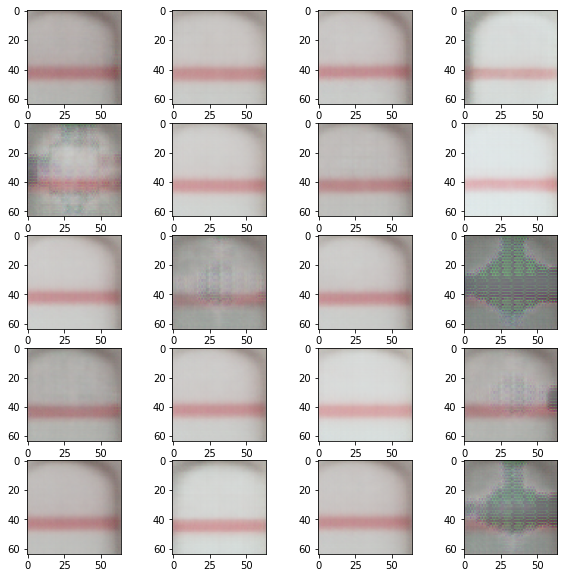

In [ ]:
z = torch.randn(size=(20, LATENT_DIM)).to(DEVICE)
z = z * 1
x_hat = model.decode(z)
x_hat[x_hat < 0.] = 0
x_hat = x_hat.view(20, NUM_CHANNELS, IMG_SIZE, IMG_SIZE)
fig, ax = plt.subplots(nrows=5, ncols=4, figsize=(10, 10))
for i in range(20):
  row, column = i % 5, i // 5
  image = x_hat[i, :, :, :].cpu().detach().permute(1,2,0).numpy()
  # image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
  ax[row][column].imshow(image)

plt.savefig('samples.png')
plt.show()

In [ ]:
DEVICE = 'cpu'
NUM_SAMPLES = 100
ANOMALY_DETECTED_IMAGES, NORMAL_DETECTED_IMAGES = [], []
z = torch.randn(size=(NUM_SAMPLES, LATENT_DIM)).to(DEVICE)
z = z * 100
model.eval()
model.to(DEVICE)

for z_ in tqdm(z, desc='Testing Synthetic Samples', position=0, leave=True):
  x = model.decode(z_)
  x[x < 0.] = 0
  x[x > 1.] = 1.
  x = x.view(1, NUM_CHANNELS, IMG_SIZE, IMG_SIZE).to(DEVICE)

  x_hat, mu, logvar = model(x)
  loss = model.loss_function(x=x, x_hat=x_hat, mu=mu, logvar=logvar)

  if loss >= threshold:
    ANOMALY_DETECTED_IMAGES.append(x_hat)
  else:
    NORMAL_DETECTED_IMAGES.append(x_hat)

Testing Synthetic Samples: 100%|██████████| 100/100 [00:00<00:00, 123.92it/s]


In [ ]:
len(NORMAL_DETECTED_IMAGES), len(ANOMALY_DETECTED_IMAGES)

(9, 91)

IndexError: ignored

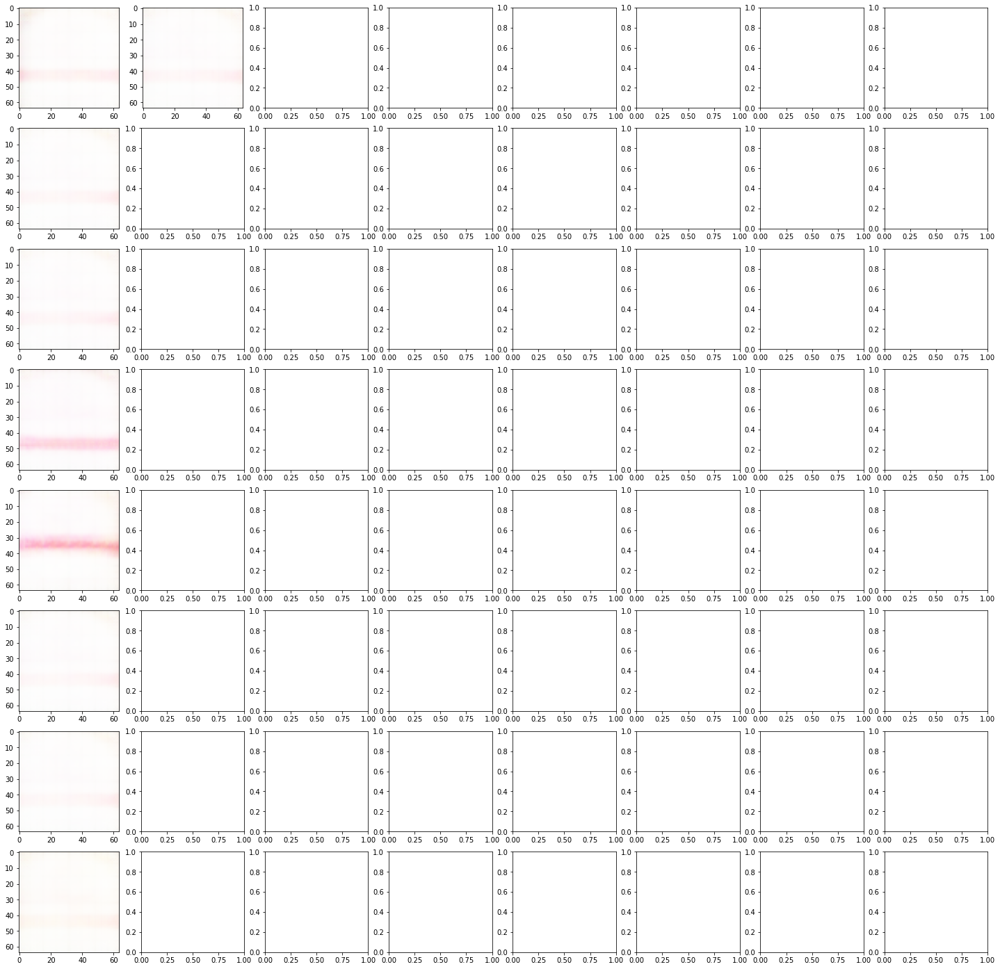

In [ ]:
random.shuffle(NORMAL_DETECTED_IMAGES)
fig, ax = plt.subplots(nrows=8, ncols=8, figsize=(25, 25))
for i in range(64):
  row, column = i % 8, i // 8
  image = NORMAL_DETECTED_IMAGES[i][0, :, :, :].cpu().detach().permute(1,2,0).numpy()
  ax[row][column].imshow(image)

plt.savefig('normal_detected_samples.png')
plt.show()

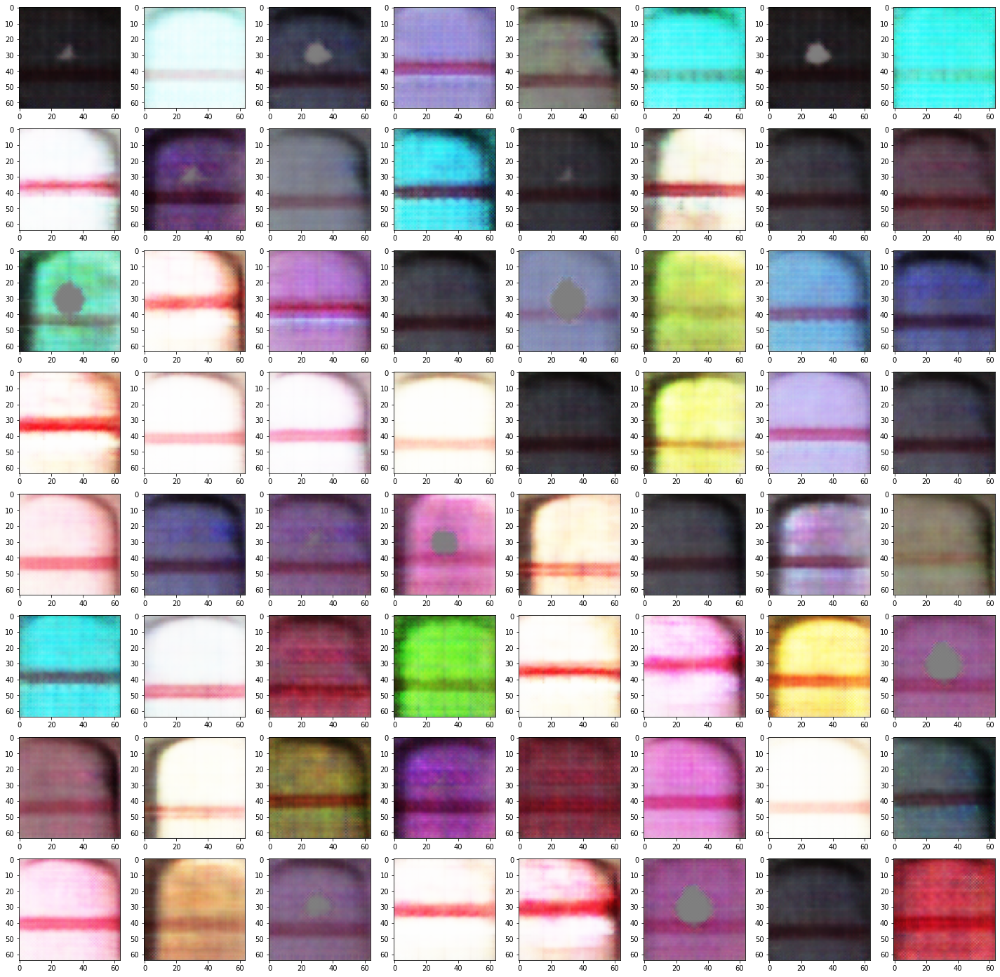

In [ ]:
random.shuffle(ANOMALY_DETECTED_IMAGES)
fig, ax = plt.subplots(nrows=8, ncols=8, figsize=(25, 25))
for i in range(64):
  row, column = i % 8, i // 8
  image = ANOMALY_DETECTED_IMAGES[i][0, :, :, :].cpu().detach().permute(1,2,0).numpy()
  ax[row][column].imshow(image)

plt.savefig('normal_detected_samples.png')
plt.show()